### Библиотеки

In [20]:
import numpy as np
import pydicom as dc
from glob import glob
import matplotlib.pyplot as plt
from PIL import Image
import pandas as pd

from tqdm import tqdm_notebook, tqdm

from keras import Model
from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from keras.models import load_model
from tensorflow.keras.optimizers import Adam
from keras.layers import Input, Conv2D, Conv2DTranspose, MaxPooling2D, concatenate, BatchNormalization, Dropout, Lambda
from keras.losses import binary_crossentropy
import tensorflow as tf
import keras as keras
from keras.preprocessing import image

from keras import backend as K

# import os
# os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

In [21]:
# SIZE_X = 512 
# SIZE_Y = 512
# n_classes = 4
# num_images = 40

### Считывание Train/Test в Numpy массивы
1) Изображения записаны в формате ***dicom***. Для их чтения используем специальную библиотеку *pydicom*

2) В разметке имеется всего 4 класса: 
* 0 - фон, 
* 1 - висцеральный жир, кости, органы
* 2 - мышцы и внутримышечный жир, кости
* 3 - подкожный жир


In [22]:
train_names = sorted(glob('../input/segm-med/train/DICOM/*'))
test_names = sorted(glob('../input/segm-med/test/DICOM/*'))
label_names = sorted(glob('../input/segm-med/train/Label/*'))
label_names_test = sorted(glob('../input/segm-med/test/Label/*'))

train_ds = []
test_ds = []
mask_dataset_train = []
mask_dataset_test = []

for name in train_names:
    train_ds.append(dc.dcmread(name))
for name in test_names:
    test_ds.append(dc.dcmread(name))
for label_name in label_names:
    img = Image.open(label_name)
    mask_dataset_train.append(np.asarray(img))
    
mask_dataset_train = np.asarray(mask_dataset_train)

for label_name in label_names_test:
    img = Image.open(label_name)
    mask_dataset_test.append(np.asarray(img))
    
mask_dataset_test = np.asarray(mask_dataset_test)


In [23]:
image_dataset_train = []
image_dataset_test = []
for sample_ds in train_ds:
    image_dataset_train.append(sample_ds.pixel_array)
for sample_ds in test_ds:
    image_dataset_test.append(sample_ds.pixel_array)
    
image_dataset_train = np.asarray(image_dataset_train)
image_dataset_test = np.asarray(image_dataset_test)

In [24]:
#horizontal_flip
# img_generator = image.ImageDataGenerator(
#          horizontal_flip=True
# )

# for i in range(40):
#     x = np.expand_dims(image_dataset_train[i], axis = 0)
#     x = x[:, :, :, np.newaxis]
#     gen = img_generator.flow(x, batch_size=1)
#     x_batch = next(gen)
#     image_dataset_train = np.append(image_dataset_train, [x_batch[0][:, :, 0]], axis = 0)
    
#     y = np.expand_dims(mask_dataset_train[i], axis = 0)
#     y = y[:, :, :, np.newaxis]
#     gen = img_generator.flow(y, batch_size=1)
#     y_batch = next(gen)
#     mask_dataset_train = np.append(mask_dataset_train, [y_batch[0][:, :, 0]], axis = 0)

    

In [25]:
print("Image data shape is: ", image_dataset_train.shape)
print("Mask data shape is: ", mask_dataset_train.shape)
print("Max pixel value in image is: ", image_dataset_train.max())
print("Labels in the mask are : ", np.unique(mask_dataset_train))

Image data shape is:  (40, 512, 512)
Mask data shape is:  (40, 512, 512)
Max pixel value in image is:  3071
Labels in the mask are :  [0 1 2 3]


In [26]:
image_dataset_train = np.expand_dims(image_dataset_train, axis = 3)
image_dataset_test = np.expand_dims(image_dataset_test, axis = 3)
mask_dataset_train = np.expand_dims(mask_dataset_train, axis = 3)

In [27]:
print("Image data shape is: ", image_dataset_train.shape)
print("Mask data shape is: ", mask_dataset_train.shape)
print("Max pixel value in image is: ", image_dataset_train.max())
print("Labels in the mask are : ", np.unique(mask_dataset_train))

Image data shape is:  (40, 512, 512, 1)
Mask data shape is:  (40, 512, 512, 1)
Max pixel value in image is:  3071
Labels in the mask are :  [0 1 2 3]


In [28]:
from sklearn.model_selection import train_test_split
X_train, X_valid, y_train, y_valid = train_test_split(image_dataset_train, mask_dataset_train, test_size = 0.2, random_state = 42)

X_test = image_dataset_test
y_test = mask_dataset_test
y_valid.shape, y_train.shape

((8, 512, 512, 1), (32, 512, 512, 1))

In [29]:
from tensorflow.keras.utils import to_categorical
y_train_cat = to_categorical(y_train, num_classes=4)
print(y_train_cat.shape)

y_test_cat = to_categorical(y_valid, num_classes=4)

(32, 512, 512, 4)


### Визуализация данных

In [30]:
# nrows, ncols = 20, 4
# fig, ax = plt.subplots(nrows=nrows, ncols=ncols)
# fig.set_figheight(100), fig.set_figwidth(100 * ncols // nrows)
# j = 0
# for i, (X, y) in enumerate(zip(X_train, y_train)):
#     if i == nrows * ncols // 2:
#         break
#     ax[2 * i // ncols, 2 * i % ncols].imshow(X)
#     ax[2 * i // ncols, 2 * i % ncols].set_title(str(j))
#     ax[(2 * i + 1) // ncols, (2 * i + 1) % ncols].imshow(y)
#     ax[(2 * i + 1) // ncols, (2 * i + 1) % ncols].set_title(str(j))
#     j+= 1

##### 3.2. Один из семплов в ЧБ формате 

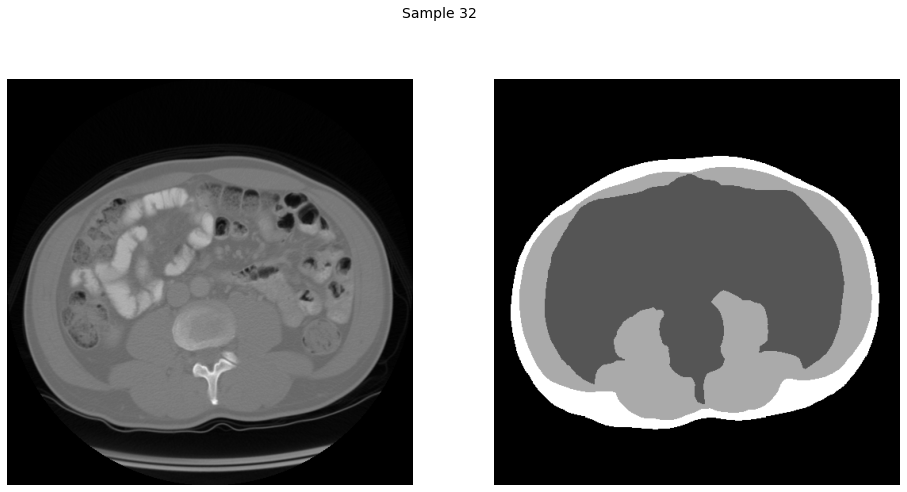

In [31]:
fig, ax = plt.subplots(ncols=2)
fig.set_figheight(8), fig.set_figwidth(16)
fig.suptitle(f'Sample {X_train.shape[0]}', fontsize=14)
ax[0].imshow(X_train[-1], cmap='gray')
ax[0].axis('off'), ax[1].axis('off')
_ = ax[1].imshow(y_train[-1], cmap='gray')

### 4. Алгоритм для Сегментации
Предлагается реализовать алгоритм для сегментации мышц и жира на снимках КТ на основе глубинного машинного обучения.

In [32]:
from keras.models import Model
from keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, Conv2DTranspose, BatchNormalization, Dropout, Activation, MaxPool2D, Concatenate
from tensorflow.keras.optimizers import Adam
from keras.layers import LeakyReLU


def conv(input, num_filters):
    x = Conv2D(num_filters, 3, padding="same")(input)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)
#     x = LeakyReLU(alpha=0.01)(x)

    x = Conv2D(num_filters, 3, padding="same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)
#     x = LeakyReLU(alpha=0.01)(x)

    return x


def encoder(input, num_filters):
    x = conv(input, num_filters)
    p = MaxPool2D((2, 2))(x)
#     p = Dropout(0.5)(p)

    return x, p   

def decoder(input, features, num_filters):
    x = Conv2DTranspose(num_filters, (2, 2), strides=2, padding="same")(input)
    x = Concatenate()([x, features])
    x = conv(x, num_filters)
    
    return x


def unet(input_shape):
    inputs = Input(input_shape)

    s1, p1 = encoder(inputs, 64)
    s2, p2 = encoder(p1, 128)
    s3, p3 = encoder(p2, 256)
    s4, p4 = encoder(p3, 512)

    b1 = conv(p4, 1024)

    d1 = decoder(b1, s4, 512)
    d2 = decoder(d1, s3, 256)
    d3 = decoder(d2, s2, 128)
    d4 = decoder(d3, s1, 64)

    outputs = Conv2D(4, 1, padding="same", activation='softmax')(d4)
    
    model = Model(inputs, outputs)
    
    return model

In [33]:
input_shape = (X_train.shape[1], X_train.shape[2], X_train.shape[3])

In [34]:
model = unet(input_shape)
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model.summary()

2022-11-03 15:25:47.246333: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-11-03 15:25:47.367988: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-11-03 15:25:47.368875: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-11-03 15:25:47.370194: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compil

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 512, 512, 1) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 512, 512, 64) 640         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 512, 512, 64) 256         conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 512, 512, 64) 0           batch_normalization[0][0]        
______________________________________________________________________________________________

### TRAIN

epoch 1:


2022-11-03 15:25:57.745864: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)
2022-11-03 15:26:00.599294: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8005


11/11 [==============================] - 19s 707ms/step - loss: 0.6007 - accuracy: 0.7554 - val_loss: 1258.4631 - val_accuracy: 0.2058
1 1
epoch 2:
11/11 [==============================] - 4s 388ms/step - loss: 0.3423 - accuracy: 0.8648 - val_loss: 7339.6655 - val_accuracy: 0.5541
1 1
epoch 3:
11/11 [==============================] - 4s 388ms/step - loss: 0.2908 - accuracy: 0.8909 - val_loss: 535.4262 - val_accuracy: 0.5083
1 1
epoch 4:
11/11 [==============================] - 4s 389ms/step - loss: 0.2451 - accuracy: 0.9138 - val_loss: 894.8057 - val_accuracy: 0.2640
1 1
epoch 5:
11/11 [==============================] - 4s 389ms/step - loss: 0.1984 - accuracy: 0.9305 - val_loss: 220.7467 - val_accuracy: 0.4787
1 1
epoch 6:
11/11 [==============================] - 4s 386ms/step - loss: 0.1470 - accuracy: 0.9531 - val_loss: 208.9710 - val_accuracy: 0.5598
1 1
epoch 7:
11/11 [==============================] - 4s 387ms/step - loss: 0.1237 - accuracy: 0.9586 - val_loss: 242.8073 - val_accur

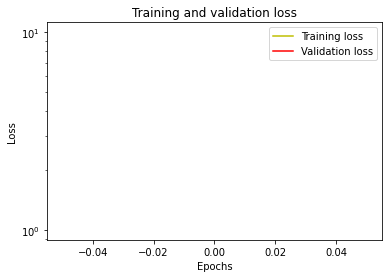

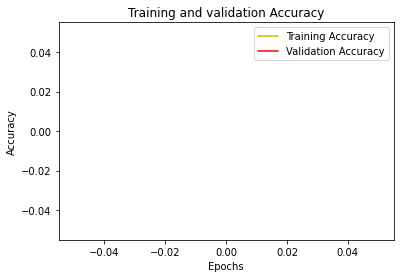

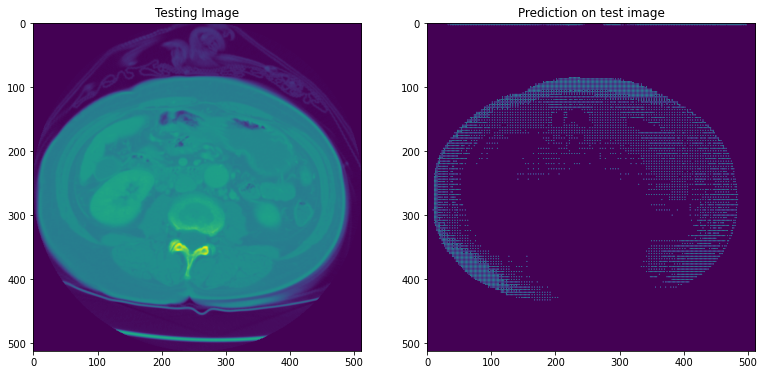

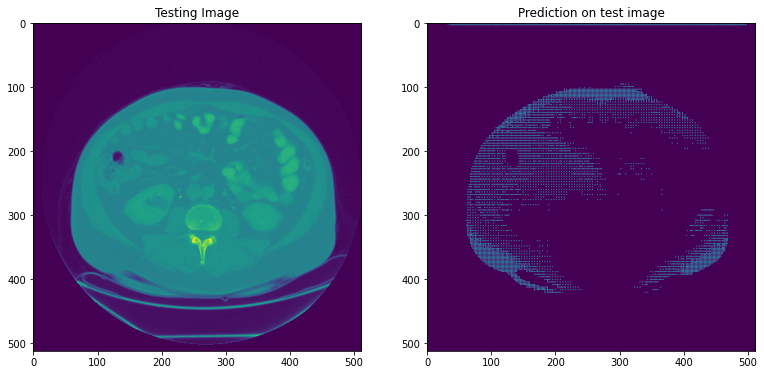

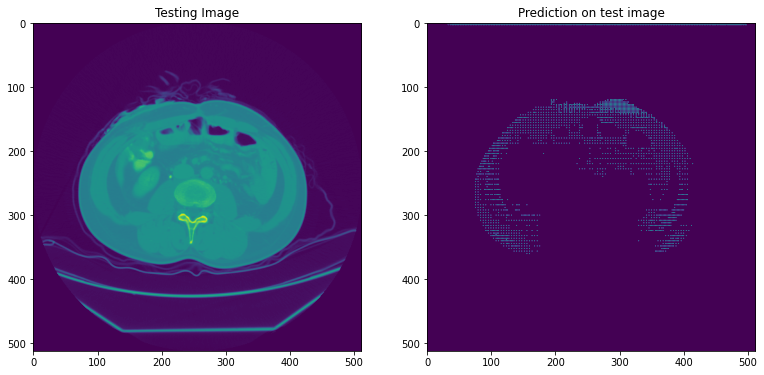

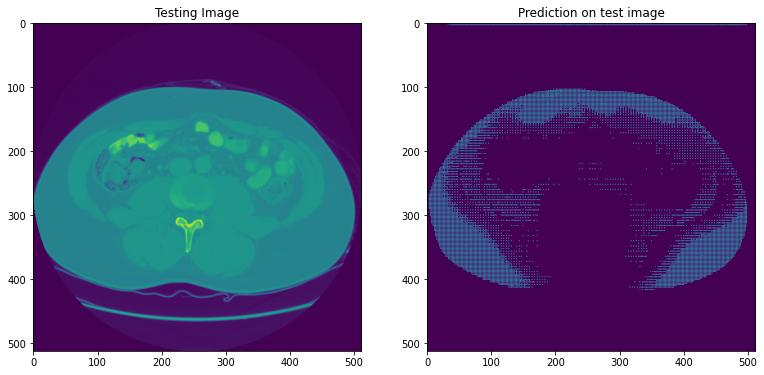

epoch 11:
11/11 [==============================] - 4s 385ms/step - loss: 0.0953 - accuracy: 0.9665 - val_loss: 5.3026 - val_accuracy: 0.6198
1 1
epoch 12:
11/11 [==============================] - 4s 385ms/step - loss: 0.0966 - accuracy: 0.9664 - val_loss: 3.3003 - val_accuracy: 0.7377
1 1
epoch 13:
11/11 [==============================] - 4s 391ms/step - loss: 0.0758 - accuracy: 0.9740 - val_loss: 1.4880 - val_accuracy: 0.7507
1 1
epoch 14:
11/11 [==============================] - 4s 394ms/step - loss: 0.0721 - accuracy: 0.9738 - val_loss: 1.3352 - val_accuracy: 0.7986
1 1
epoch 15:
11/11 [==============================] - 4s 387ms/step - loss: 0.0716 - accuracy: 0.9747 - val_loss: 2.4763 - val_accuracy: 0.7274
1 1
epoch 16:
11/11 [==============================] - 4s 384ms/step - loss: 0.0664 - accuracy: 0.9765 - val_loss: 1.0252 - val_accuracy: 0.7764
1 1
epoch 17:
11/11 [==============================] - 4s 393ms/step - loss: 0.0574 - accuracy: 0.9794 - val_loss: 0.6292 - val_accura

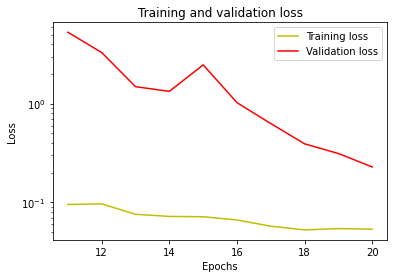

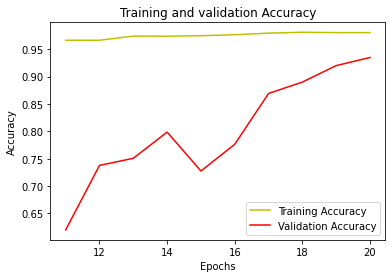

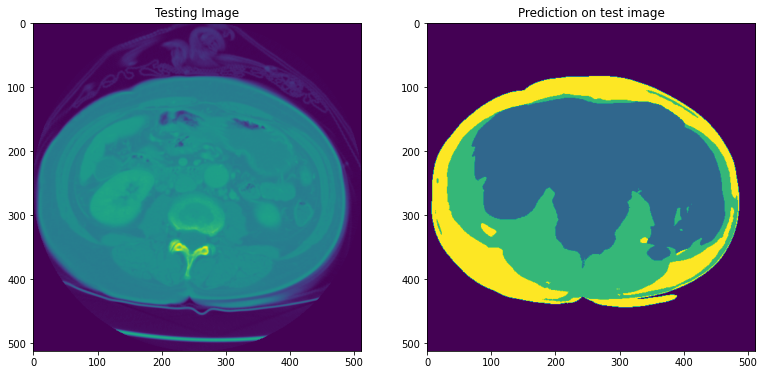

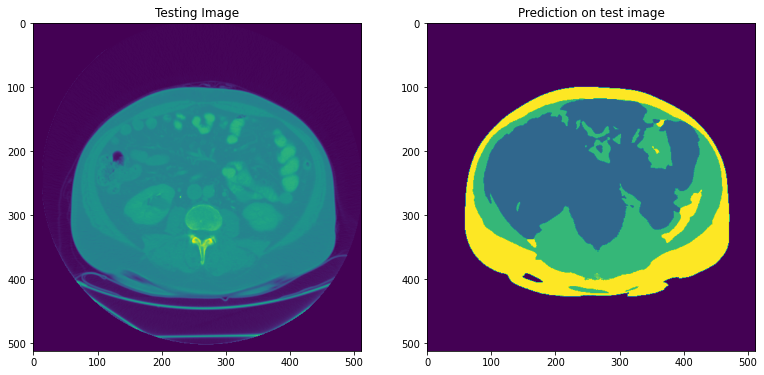

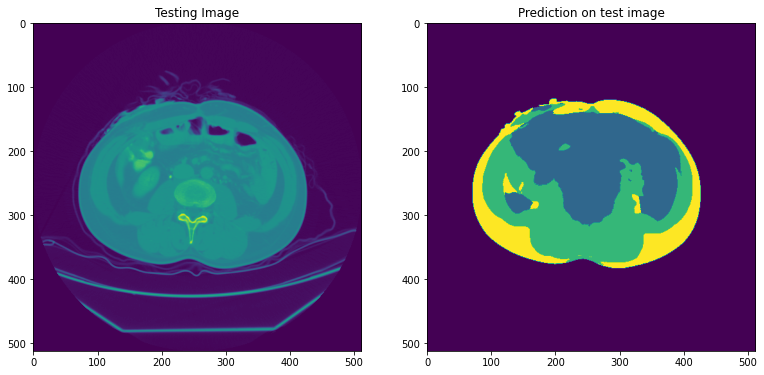

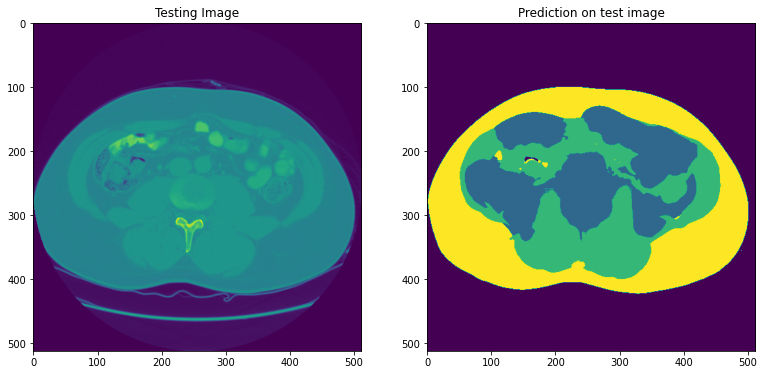

epoch 21:
11/11 [==============================] - 4s 388ms/step - loss: 0.0526 - accuracy: 0.9807 - val_loss: 0.1575 - val_accuracy: 0.9531
21 0.15745307505130768
epoch 22:
11/11 [==============================] - 4s 392ms/step - loss: 0.0544 - accuracy: 0.9804 - val_loss: 0.1701 - val_accuracy: 0.9377
21 0.15745307505130768
epoch 23:
11/11 [==============================] - 4s 394ms/step - loss: 0.0785 - accuracy: 0.9730 - val_loss: 0.1654 - val_accuracy: 0.9455
21 0.15745307505130768
epoch 24:
11/11 [==============================] - 4s 391ms/step - loss: 0.0723 - accuracy: 0.9736 - val_loss: 0.2412 - val_accuracy: 0.9186
21 0.15745307505130768
epoch 25:
11/11 [==============================] - 4s 393ms/step - loss: 0.0563 - accuracy: 0.9794 - val_loss: 0.1639 - val_accuracy: 0.9511
21 0.15745307505130768
epoch 26:
11/11 [==============================] - 4s 393ms/step - loss: 0.0502 - accuracy: 0.9815 - val_loss: 0.1432 - val_accuracy: 0.9602
26 0.14320285618305206
epoch 27:
11/11 

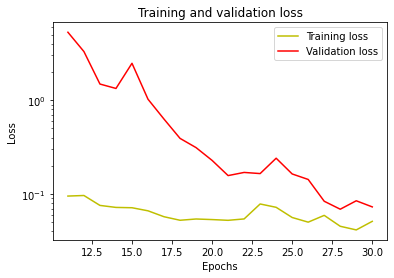

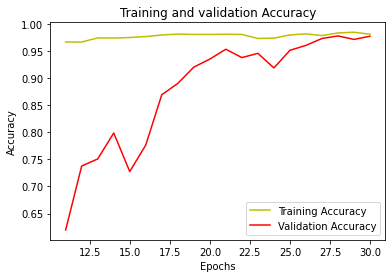

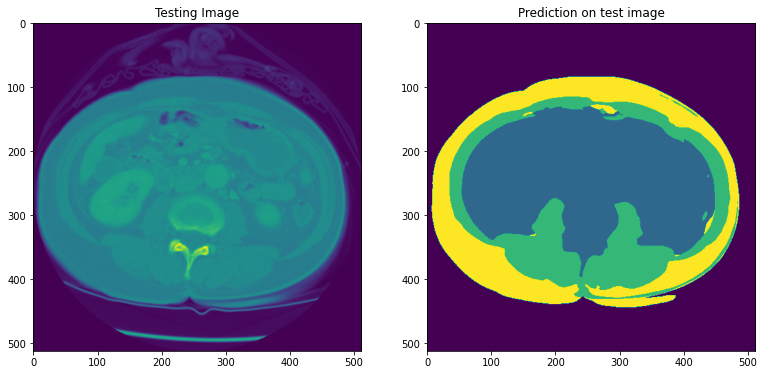

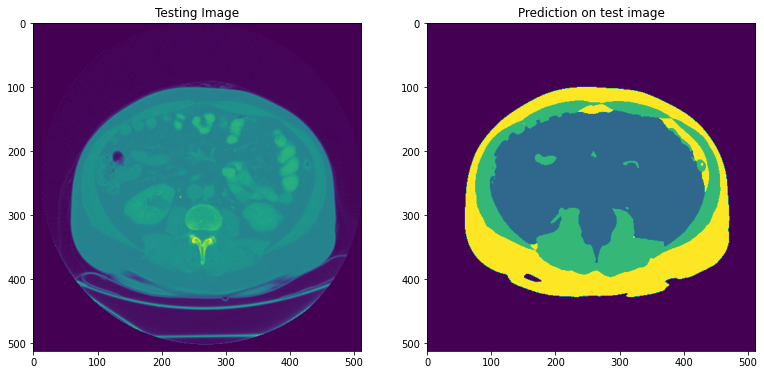

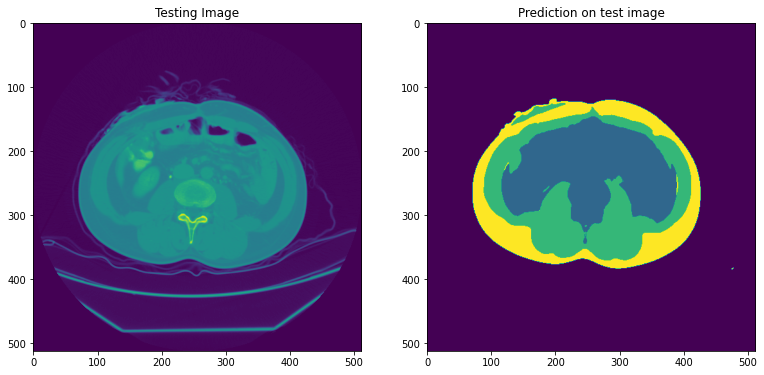

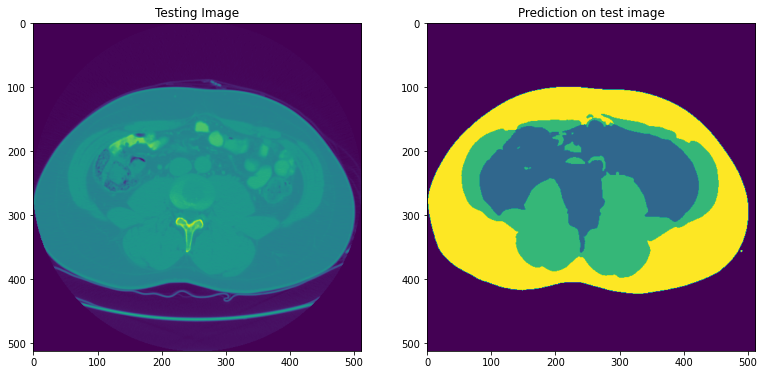

epoch 31:
11/11 [==============================] - 4s 389ms/step - loss: 0.0394 - accuracy: 0.9854 - val_loss: 0.0638 - val_accuracy: 0.9777
31 0.06377409398555756
epoch 32:
11/11 [==============================] - 4s 394ms/step - loss: 0.0412 - accuracy: 0.9844 - val_loss: 0.0653 - val_accuracy: 0.9773
31 0.06377409398555756
epoch 33:
11/11 [==============================] - 4s 401ms/step - loss: 0.0401 - accuracy: 0.9851 - val_loss: 0.0718 - val_accuracy: 0.9770
31 0.06377409398555756
epoch 34:
11/11 [==============================] - 4s 388ms/step - loss: 0.0401 - accuracy: 0.9851 - val_loss: 0.0545 - val_accuracy: 0.9812
34 0.05445336177945137
epoch 35:
11/11 [==============================] - 4s 394ms/step - loss: 0.0399 - accuracy: 0.9849 - val_loss: 0.0980 - val_accuracy: 0.9685
34 0.05445336177945137
epoch 36:
11/11 [==============================] - 4s 392ms/step - loss: 0.0363 - accuracy: 0.9863 - val_loss: 0.0469 - val_accuracy: 0.9837
36 0.046894099563360214
epoch 37:
11/11

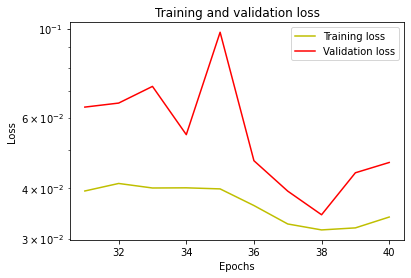

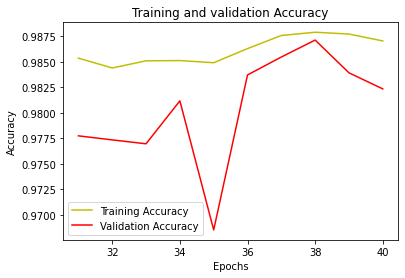

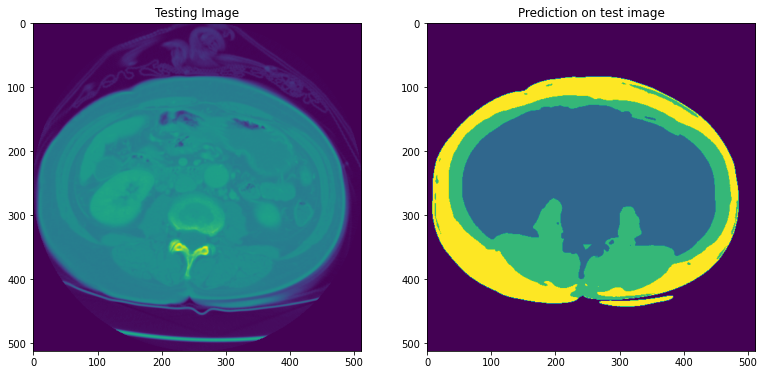

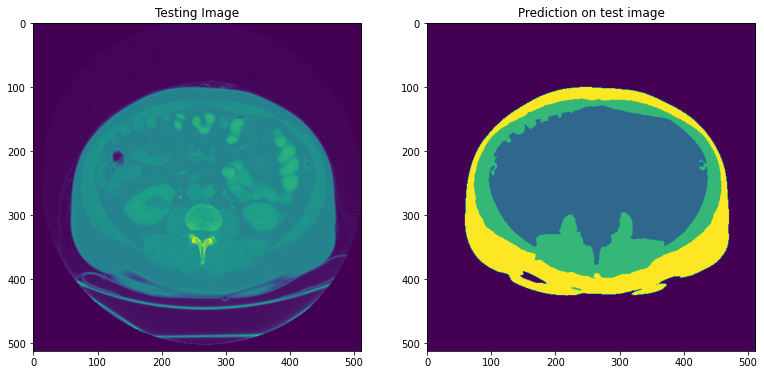

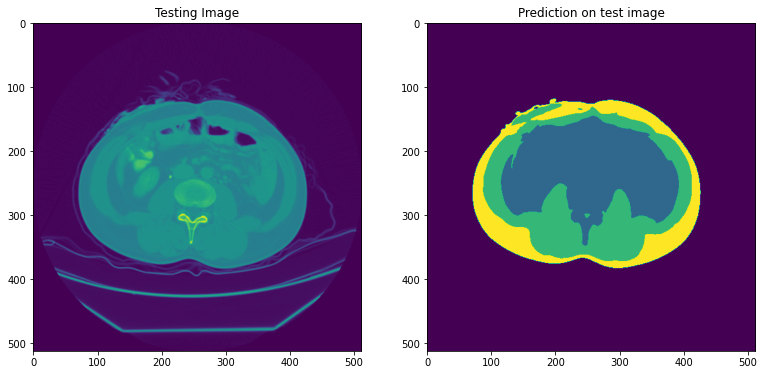

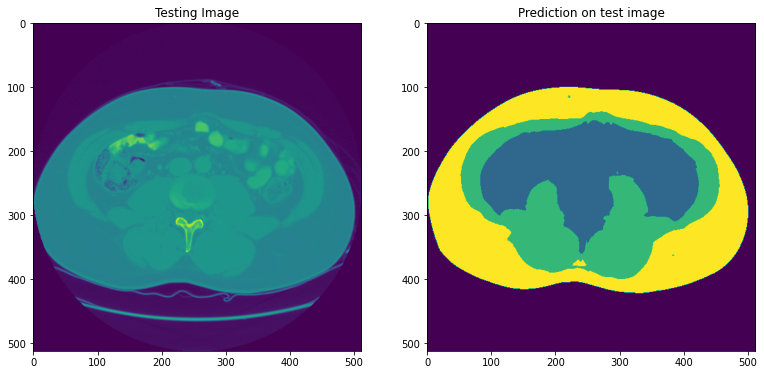

epoch 41:
11/11 [==============================] - 4s 394ms/step - loss: 0.0348 - accuracy: 0.9865 - val_loss: 0.0524 - val_accuracy: 0.9814
38 0.03439287841320038
epoch 42:
11/11 [==============================] - 4s 394ms/step - loss: 0.0316 - accuracy: 0.9878 - val_loss: 0.0342 - val_accuracy: 0.9872
42 0.034179963171482086
epoch 43:
11/11 [==============================] - 4s 402ms/step - loss: 0.0320 - accuracy: 0.9877 - val_loss: 0.0494 - val_accuracy: 0.9799
42 0.034179963171482086
epoch 44:
11/11 [==============================] - 4s 390ms/step - loss: 0.0297 - accuracy: 0.9884 - val_loss: 0.0421 - val_accuracy: 0.9836
42 0.034179963171482086
epoch 45:
11/11 [==============================] - 4s 395ms/step - loss: 0.0278 - accuracy: 0.9892 - val_loss: 0.0458 - val_accuracy: 0.9820
42 0.034179963171482086
epoch 46:
11/11 [==============================] - 4s 395ms/step - loss: 0.0280 - accuracy: 0.9890 - val_loss: 0.0448 - val_accuracy: 0.9826
42 0.034179963171482086
epoch 47:
1

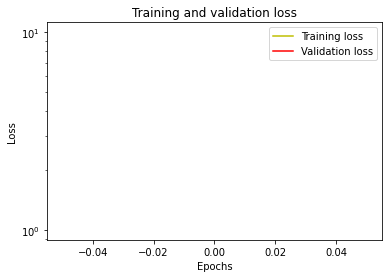

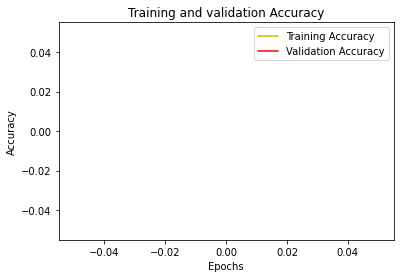

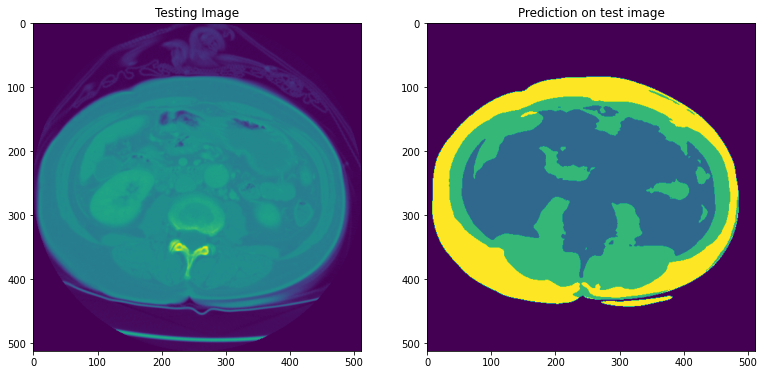

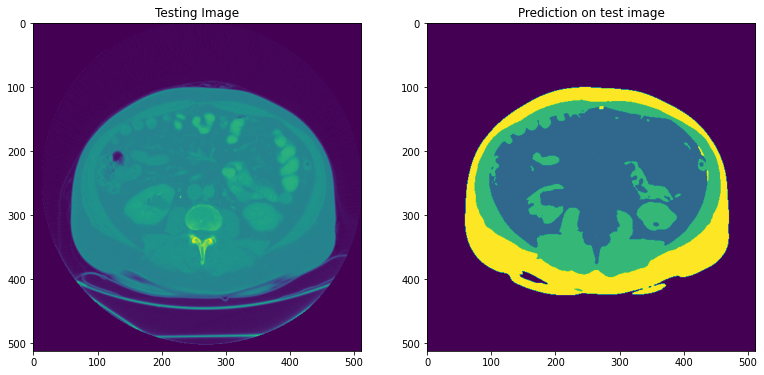

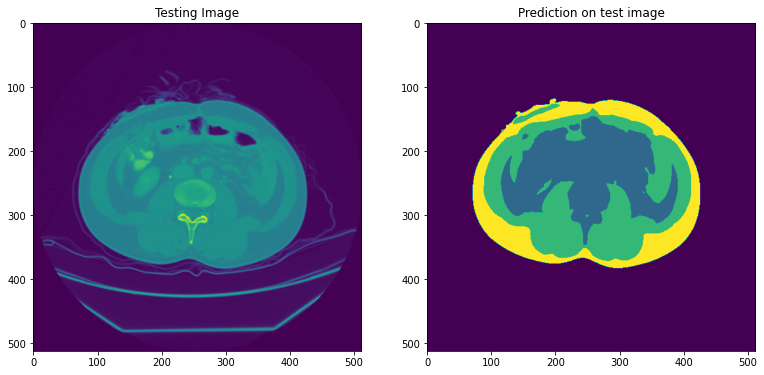

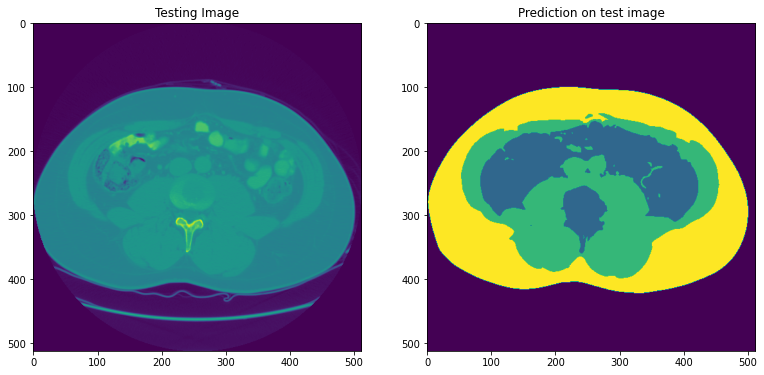

epoch 51:
11/11 [==============================] - 4s 387ms/step - loss: 0.0353 - accuracy: 0.9863 - val_loss: 0.0790 - val_accuracy: 0.9732
42 0.034179963171482086
epoch 52:
11/11 [==============================] - 4s 389ms/step - loss: 0.0332 - accuracy: 0.9871 - val_loss: 0.0605 - val_accuracy: 0.9777
42 0.034179963171482086
epoch 53:
11/11 [==============================] - 4s 392ms/step - loss: 0.0288 - accuracy: 0.9885 - val_loss: 0.0546 - val_accuracy: 0.9808
42 0.034179963171482086
epoch 54:
11/11 [==============================] - 4s 402ms/step - loss: 0.0324 - accuracy: 0.9873 - val_loss: 0.0470 - val_accuracy: 0.9825
42 0.034179963171482086
epoch 55:
11/11 [==============================] - 4s 393ms/step - loss: 0.0318 - accuracy: 0.9875 - val_loss: 0.0365 - val_accuracy: 0.9861
42 0.034179963171482086
epoch 56:
11/11 [==============================] - 4s 391ms/step - loss: 0.0284 - accuracy: 0.9887 - val_loss: 0.0335 - val_accuracy: 0.9869
56 0.03352329507470131
epoch 57:
1

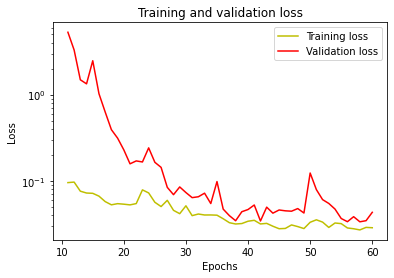

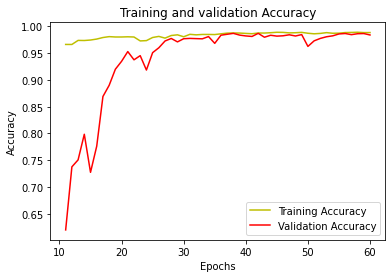

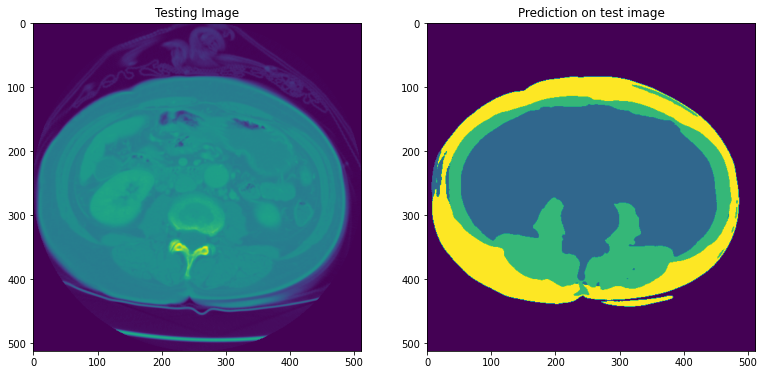

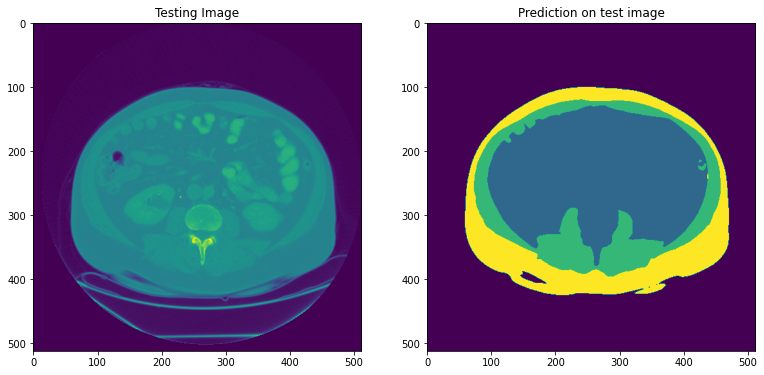

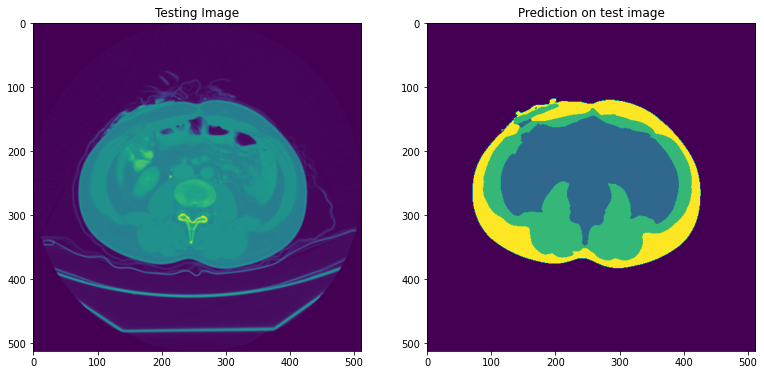

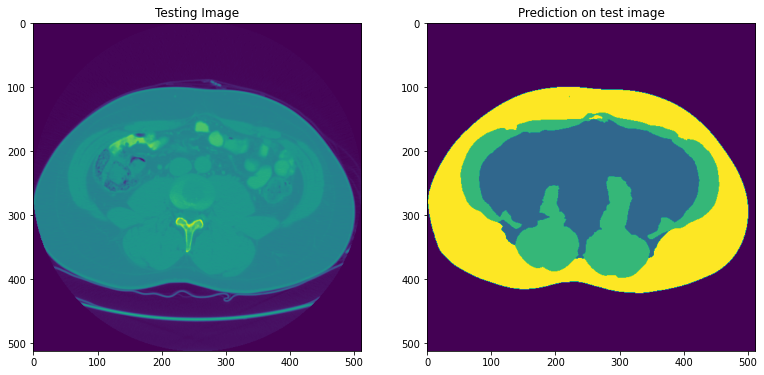

epoch 61:
11/11 [==============================] - 4s 393ms/step - loss: 0.0275 - accuracy: 0.9890 - val_loss: 0.0306 - val_accuracy: 0.9882
61 0.030589254572987556
epoch 62:
11/11 [==============================] - 4s 389ms/step - loss: 0.0273 - accuracy: 0.9889 - val_loss: 0.0276 - val_accuracy: 0.9890
62 0.02761002816259861
epoch 63:
11/11 [==============================] - 4s 387ms/step - loss: 0.0267 - accuracy: 0.9893 - val_loss: 0.0280 - val_accuracy: 0.9889
62 0.02761002816259861
epoch 64:
11/11 [==============================] - 4s 392ms/step - loss: 0.0242 - accuracy: 0.9901 - val_loss: 0.0298 - val_accuracy: 0.9880
62 0.02761002816259861
epoch 65:
11/11 [==============================] - 4s 401ms/step - loss: 0.0247 - accuracy: 0.9899 - val_loss: 0.0340 - val_accuracy: 0.9871
62 0.02761002816259861
epoch 66:
11/11 [==============================] - 4s 394ms/step - loss: 0.0255 - accuracy: 0.9897 - val_loss: 0.0313 - val_accuracy: 0.9880
62 0.02761002816259861
epoch 67:
11/11

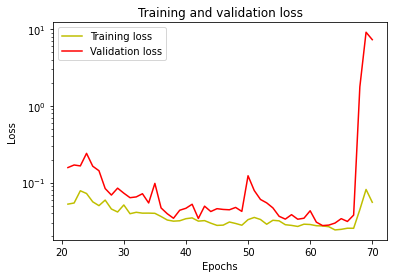

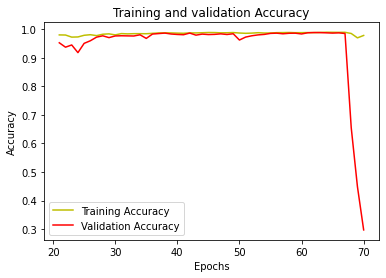

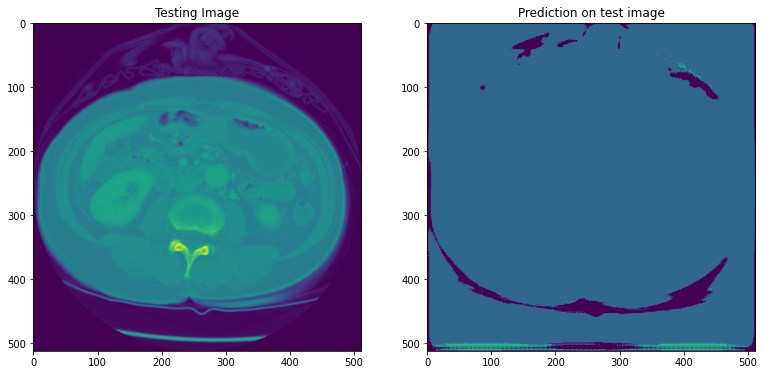

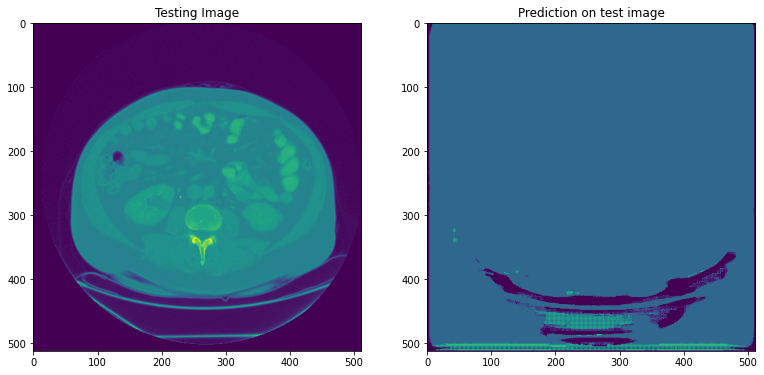

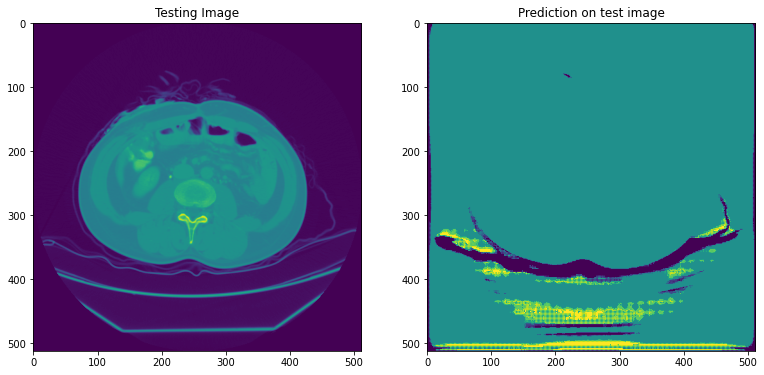

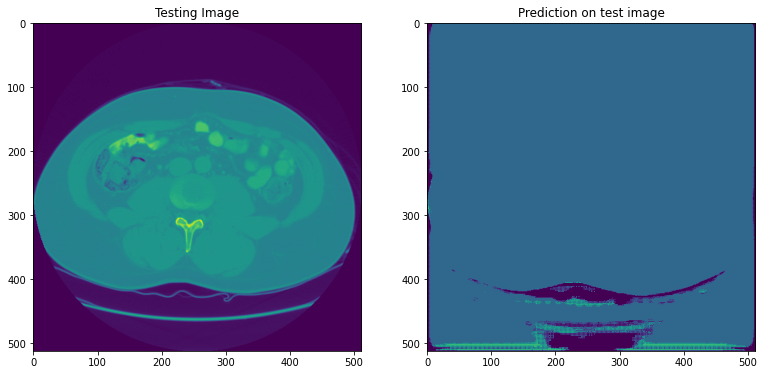

epoch 71:
11/11 [==============================] - 4s 391ms/step - loss: 0.1088 - accuracy: 0.9627 - val_loss: 37.6457 - val_accuracy: 0.2907
62 0.02761002816259861
epoch 72:
11/11 [==============================] - 4s 396ms/step - loss: 0.0824 - accuracy: 0.9719 - val_loss: 19.5754 - val_accuracy: 0.5316
62 0.02761002816259861
epoch 73:
11/11 [==============================] - 4s 390ms/step - loss: 0.0730 - accuracy: 0.9730 - val_loss: 15.3344 - val_accuracy: 0.5906
62 0.02761002816259861
epoch 74:
11/11 [==============================] - 4s 397ms/step - loss: 0.0550 - accuracy: 0.9797 - val_loss: 3.1119 - val_accuracy: 0.6516
62 0.02761002816259861
epoch 75:
11/11 [==============================] - 4s 388ms/step - loss: 0.0482 - accuracy: 0.9818 - val_loss: 1.6493 - val_accuracy: 0.7039
62 0.02761002816259861
epoch 76:
11/11 [==============================] - 4s 398ms/step - loss: 0.0422 - accuracy: 0.9838 - val_loss: 1.9493 - val_accuracy: 0.7491
62 0.02761002816259861
epoch 77:
11/

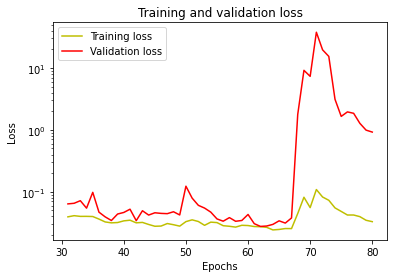

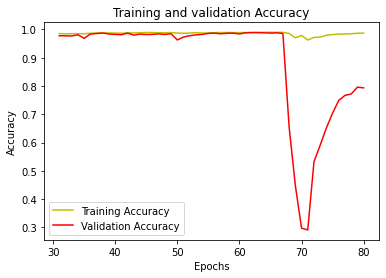

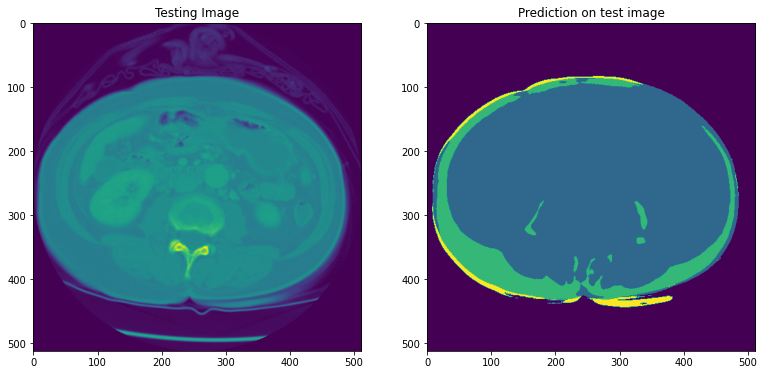

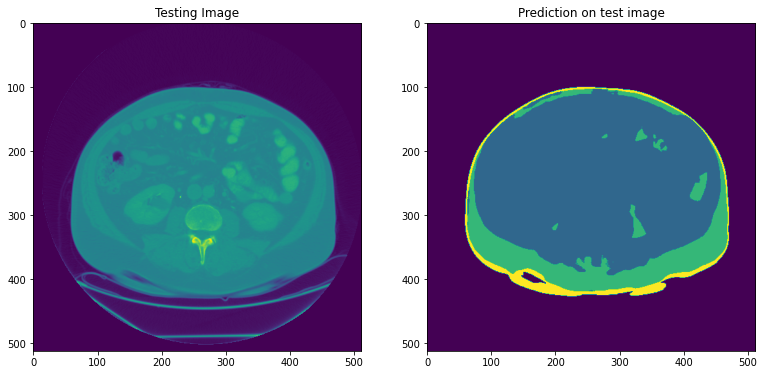

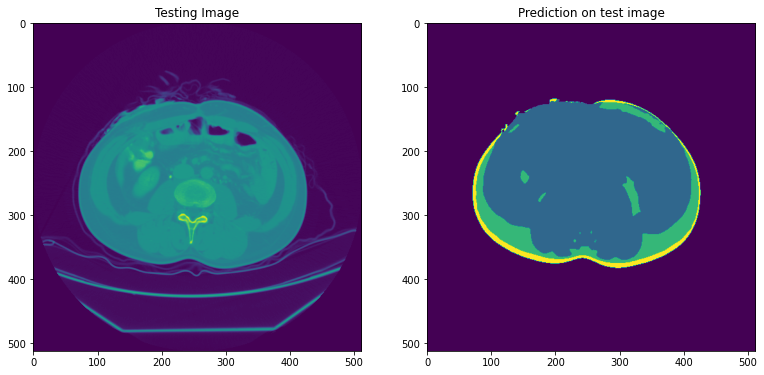

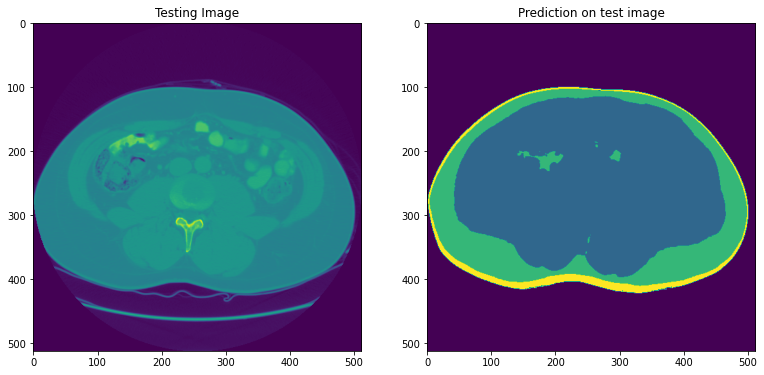

epoch 81:
11/11 [==============================] - 4s 387ms/step - loss: 0.0335 - accuracy: 0.9867 - val_loss: 0.8673 - val_accuracy: 0.8065
62 0.02761002816259861
epoch 82:
11/11 [==============================] - 4s 389ms/step - loss: 0.0313 - accuracy: 0.9877 - val_loss: 0.7424 - val_accuracy: 0.8179
62 0.02761002816259861
epoch 83:
11/11 [==============================] - 4s 393ms/step - loss: 0.0307 - accuracy: 0.9877 - val_loss: 0.5720 - val_accuracy: 0.8324
62 0.02761002816259861
epoch 84:
11/11 [==============================] - 4s 398ms/step - loss: 0.0301 - accuracy: 0.9882 - val_loss: 0.4618 - val_accuracy: 0.8493
62 0.02761002816259861
epoch 85:
11/11 [==============================] - 4s 389ms/step - loss: 0.0318 - accuracy: 0.9875 - val_loss: 0.3215 - val_accuracy: 0.9048
62 0.02761002816259861
epoch 86:
11/11 [==============================] - 4s 390ms/step - loss: 0.0283 - accuracy: 0.9887 - val_loss: 0.1176 - val_accuracy: 0.9568
62 0.02761002816259861
epoch 87:
11/11 

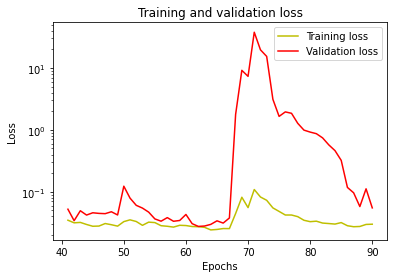

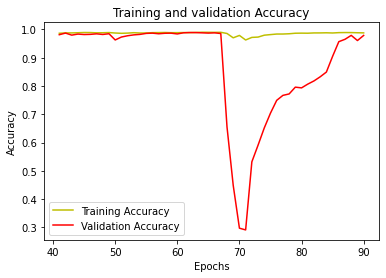

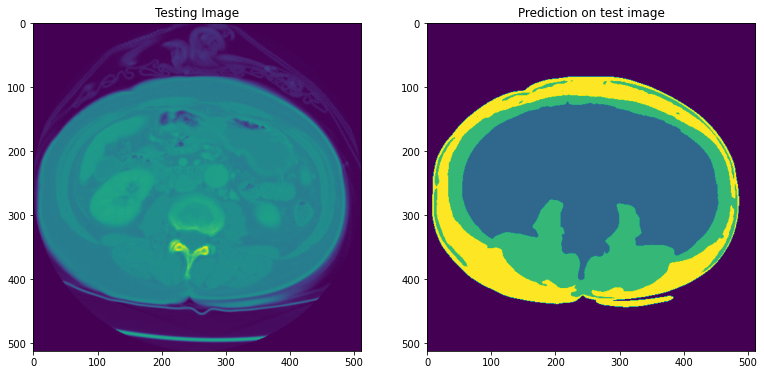

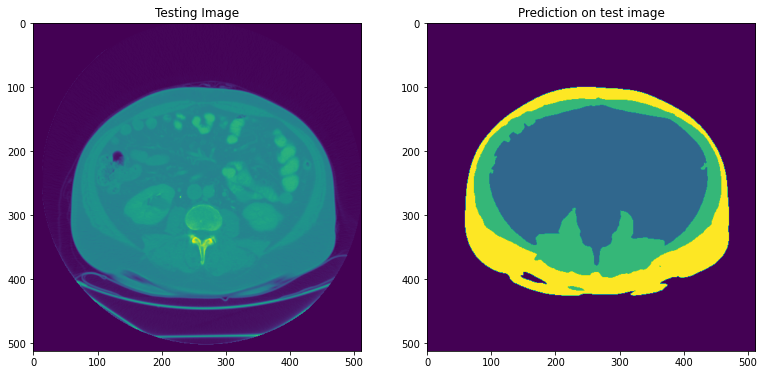

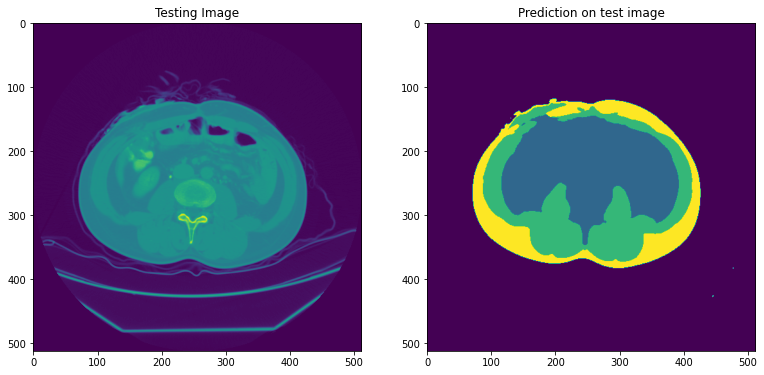

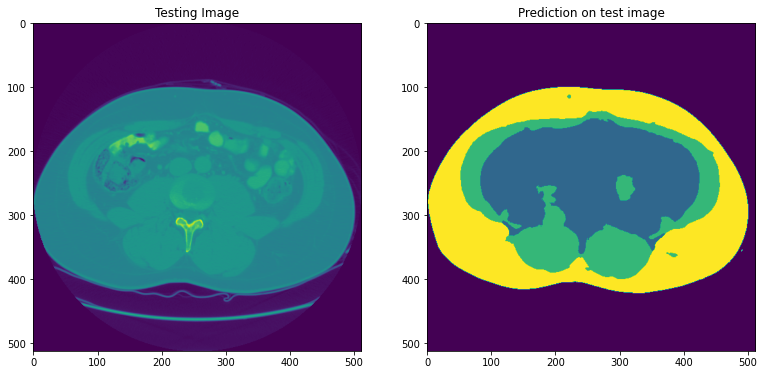

epoch 91:
11/11 [==============================] - 4s 388ms/step - loss: 0.0267 - accuracy: 0.9892 - val_loss: 0.0364 - val_accuracy: 0.9853
62 0.02761002816259861
epoch 92:
11/11 [==============================] - 4s 388ms/step - loss: 0.0265 - accuracy: 0.9892 - val_loss: 0.0398 - val_accuracy: 0.9839
62 0.02761002816259861
epoch 93:
11/11 [==============================] - 4s 393ms/step - loss: 0.0261 - accuracy: 0.9893 - val_loss: 0.0454 - val_accuracy: 0.9823
62 0.02761002816259861
epoch 94:
11/11 [==============================] - 4s 395ms/step - loss: 0.0264 - accuracy: 0.9892 - val_loss: 0.0318 - val_accuracy: 0.9877
62 0.02761002816259861
epoch 95:
11/11 [==============================] - 4s 389ms/step - loss: 0.0271 - accuracy: 0.9889 - val_loss: 0.0300 - val_accuracy: 0.9880
62 0.02761002816259861
epoch 96:
11/11 [==============================] - 4s 390ms/step - loss: 0.0250 - accuracy: 0.9899 - val_loss: 0.0406 - val_accuracy: 0.9836
62 0.02761002816259861
epoch 97:
11/11 

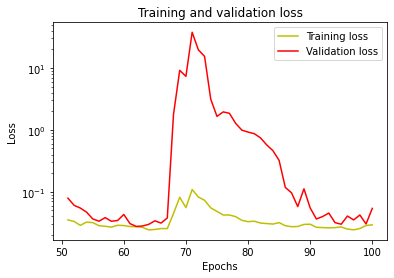

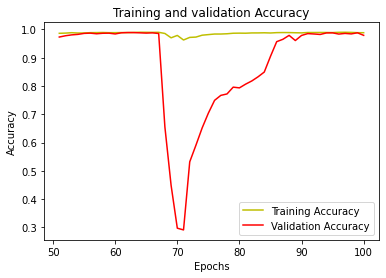

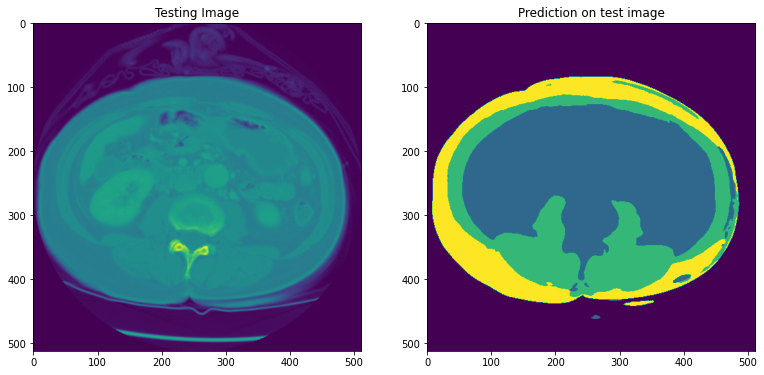

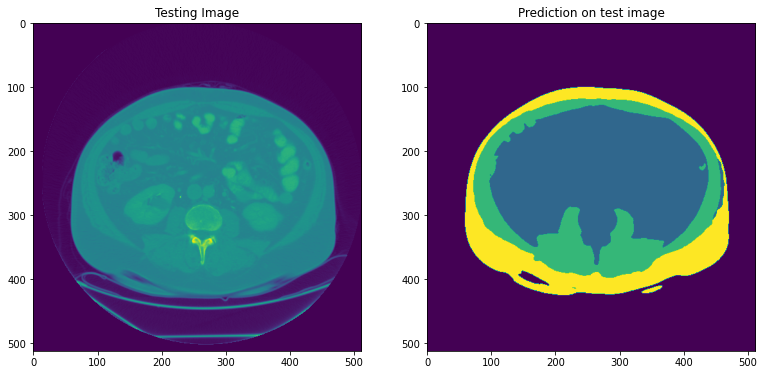

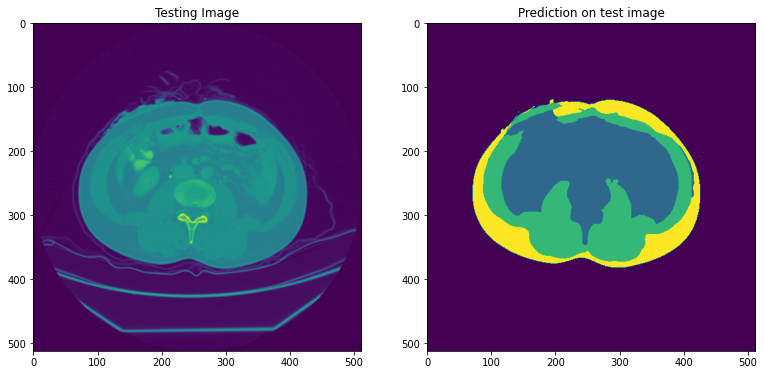

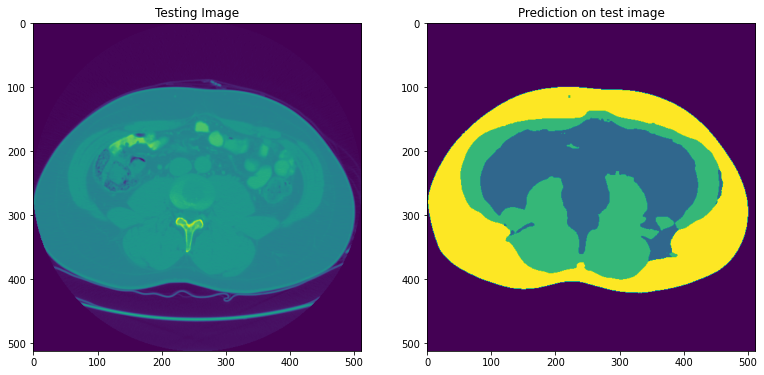

epoch 101:
11/11 [==============================] - 4s 387ms/step - loss: 0.0278 - accuracy: 0.9887 - val_loss: 0.0467 - val_accuracy: 0.9818
62 0.02761002816259861
epoch 102:
11/11 [==============================] - 4s 387ms/step - loss: 0.0270 - accuracy: 0.9890 - val_loss: 0.0372 - val_accuracy: 0.9857
62 0.02761002816259861
epoch 103:
11/11 [==============================] - 4s 393ms/step - loss: 0.0295 - accuracy: 0.9881 - val_loss: 0.0487 - val_accuracy: 0.9818
62 0.02761002816259861
epoch 104:
11/11 [==============================] - 4s 399ms/step - loss: 0.0285 - accuracy: 0.9886 - val_loss: 0.0344 - val_accuracy: 0.9863
62 0.02761002816259861
epoch 105:
11/11 [==============================] - 4s 392ms/step - loss: 0.0267 - accuracy: 0.9891 - val_loss: 0.0322 - val_accuracy: 0.9874
62 0.02761002816259861
epoch 106:
11/11 [==============================] - 4s 389ms/step - loss: 0.0253 - accuracy: 0.9898 - val_loss: 0.0411 - val_accuracy: 0.9838
62 0.02761002816259861
epoch 107:

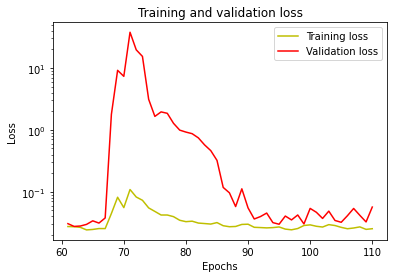

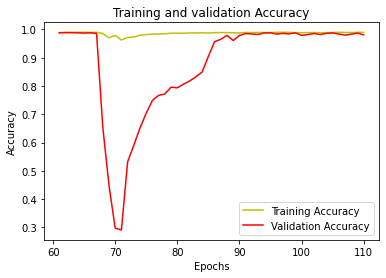

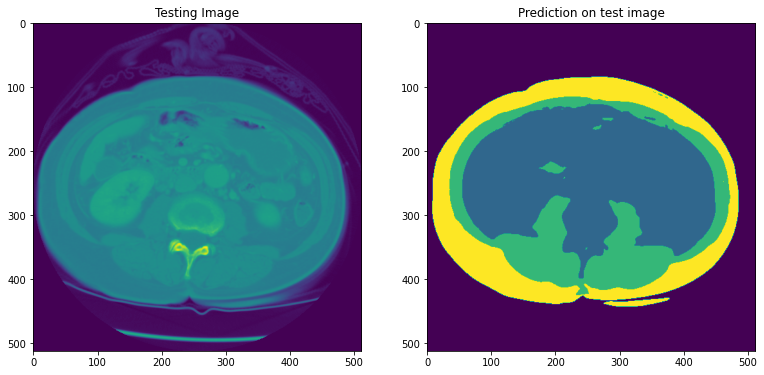

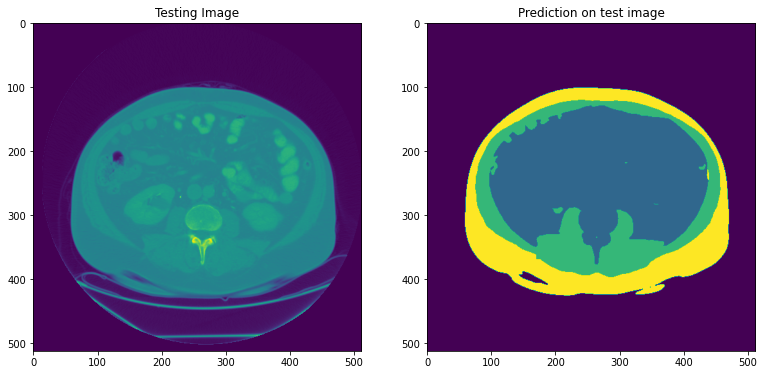

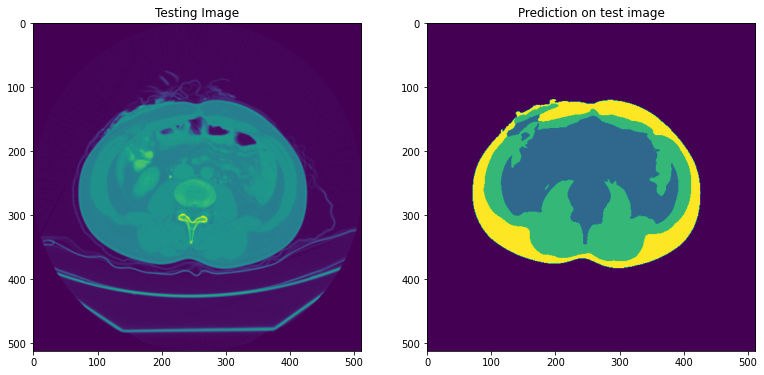

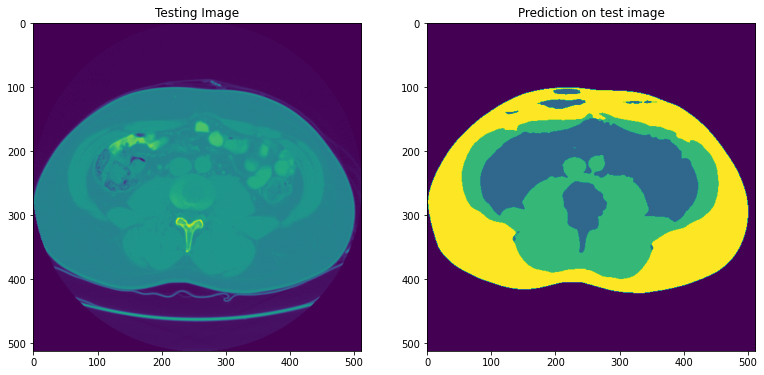

epoch 111:
11/11 [==============================] - 5s 417ms/step - loss: 0.0247 - accuracy: 0.9898 - val_loss: 0.0400 - val_accuracy: 0.9845
62 0.02761002816259861
epoch 112:
11/11 [==============================] - 4s 389ms/step - loss: 0.0304 - accuracy: 0.9878 - val_loss: 0.0307 - val_accuracy: 0.9881
62 0.02761002816259861
epoch 113:
11/11 [==============================] - 4s 392ms/step - loss: 0.0283 - accuracy: 0.9889 - val_loss: 0.0462 - val_accuracy: 0.9818
62 0.02761002816259861
epoch 114:
11/11 [==============================] - 4s 394ms/step - loss: 0.0281 - accuracy: 0.9887 - val_loss: 0.0268 - val_accuracy: 0.9890
114 0.026781335473060608
epoch 115:
11/11 [==============================] - 4s 389ms/step - loss: 0.0312 - accuracy: 0.9876 - val_loss: 0.0356 - val_accuracy: 0.9860
114 0.026781335473060608
epoch 116:
11/11 [==============================] - 4s 391ms/step - loss: 0.0287 - accuracy: 0.9885 - val_loss: 0.0430 - val_accuracy: 0.9835
114 0.026781335473060608
epoc

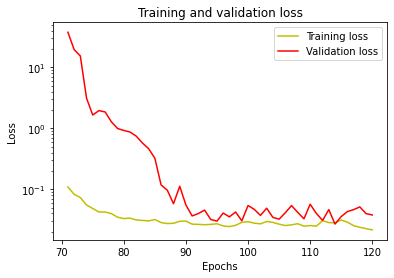

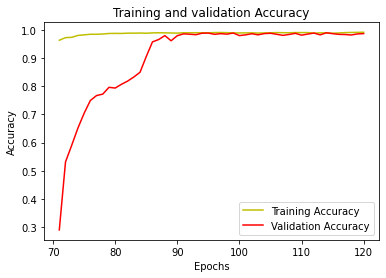

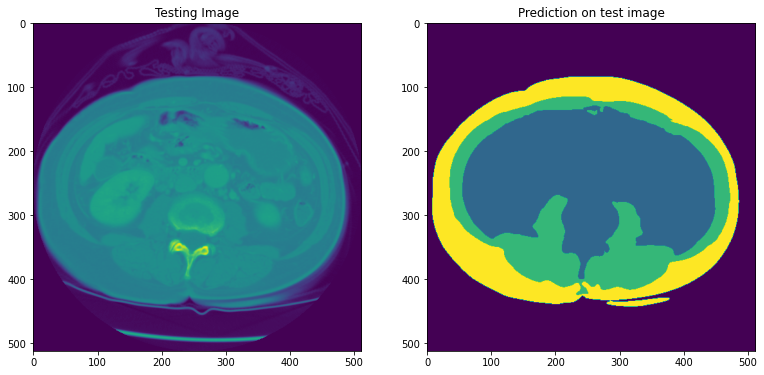

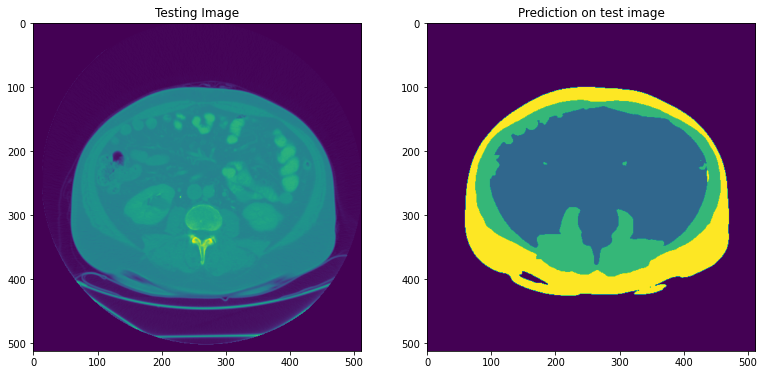

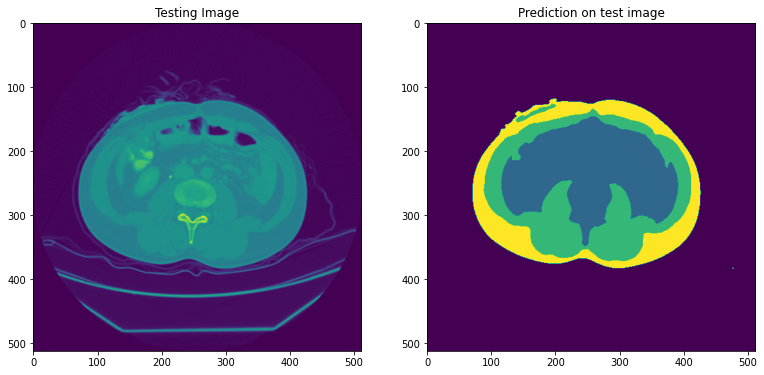

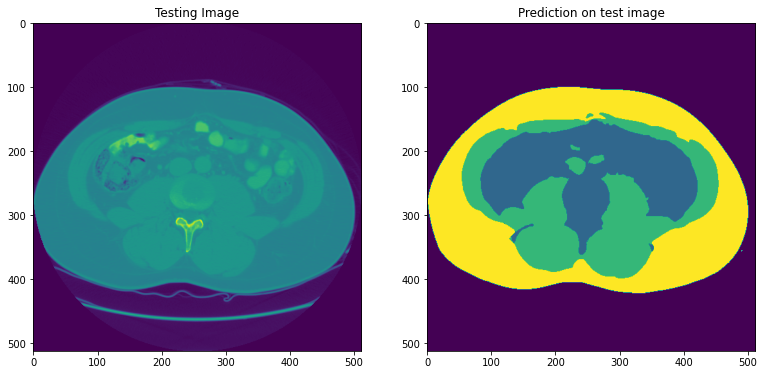

epoch 121:
11/11 [==============================] - 4s 387ms/step - loss: 0.0228 - accuracy: 0.9906 - val_loss: 0.0296 - val_accuracy: 0.9884
114 0.026781335473060608
epoch 122:
11/11 [==============================] - 4s 396ms/step - loss: 0.0223 - accuracy: 0.9906 - val_loss: 0.0354 - val_accuracy: 0.9867
114 0.026781335473060608
epoch 123:
11/11 [==============================] - 4s 392ms/step - loss: 0.0216 - accuracy: 0.9910 - val_loss: 0.0280 - val_accuracy: 0.9891
114 0.026781335473060608
epoch 124:
11/11 [==============================] - 4s 397ms/step - loss: 0.0213 - accuracy: 0.9910 - val_loss: 0.0299 - val_accuracy: 0.9887
114 0.026781335473060608
epoch 125:
11/11 [==============================] - 4s 390ms/step - loss: 0.0213 - accuracy: 0.9910 - val_loss: 0.0302 - val_accuracy: 0.9887
114 0.026781335473060608
epoch 126:
11/11 [==============================] - 4s 393ms/step - loss: 0.0210 - accuracy: 0.9911 - val_loss: 0.0373 - val_accuracy: 0.9867
114 0.02678133547306060

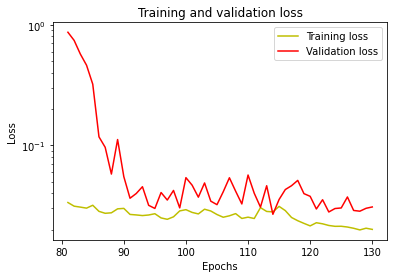

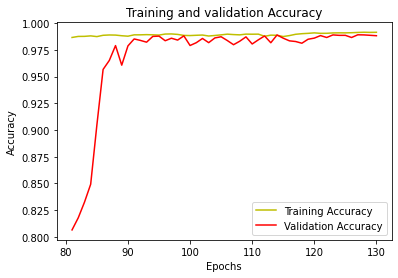

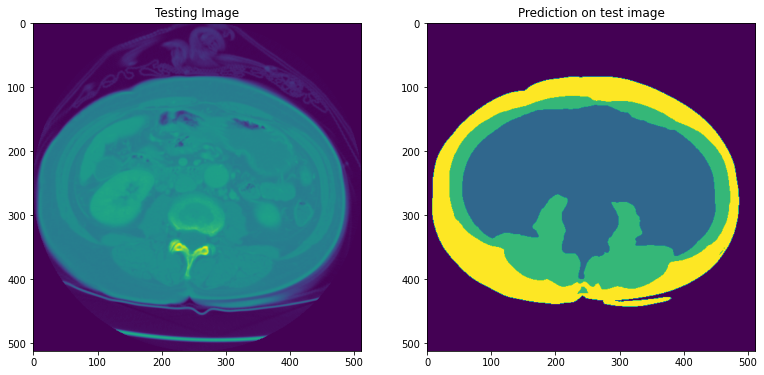

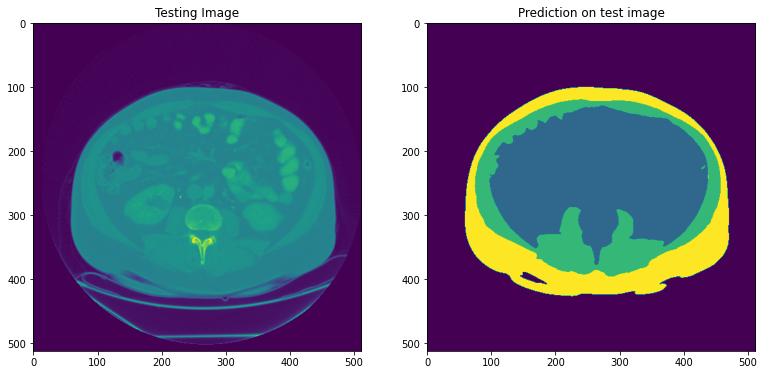

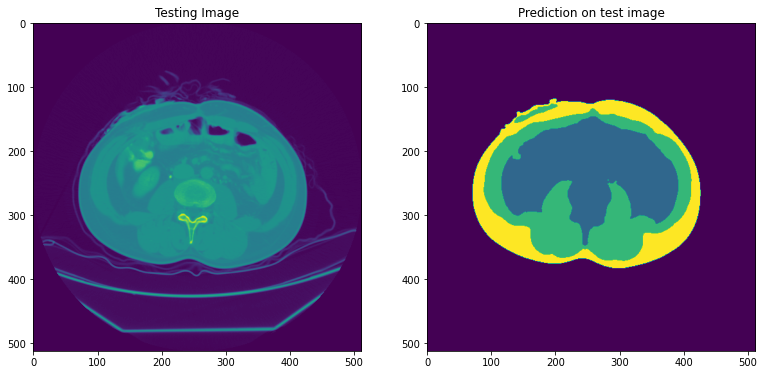

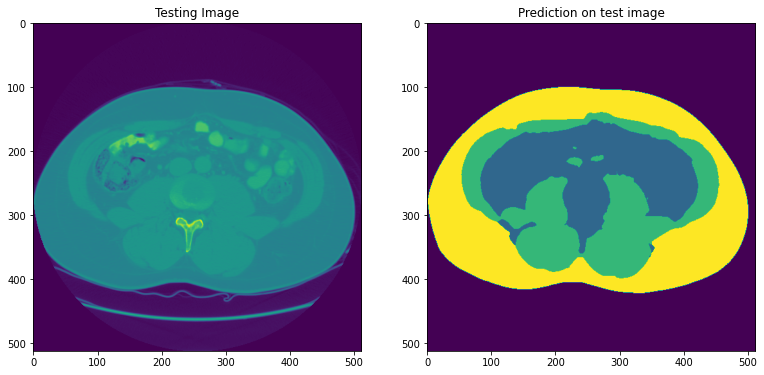

epoch 131:
11/11 [==============================] - 4s 387ms/step - loss: 0.0195 - accuracy: 0.9917 - val_loss: 0.0345 - val_accuracy: 0.9874
114 0.026781335473060608
epoch 132:
11/11 [==============================] - 4s 388ms/step - loss: 0.0215 - accuracy: 0.9910 - val_loss: 0.0321 - val_accuracy: 0.9885
114 0.026781335473060608
epoch 133:
11/11 [==============================] - 4s 392ms/step - loss: 0.0317 - accuracy: 0.9878 - val_loss: 0.0423 - val_accuracy: 0.9843
114 0.026781335473060608
epoch 134:
11/11 [==============================] - 4s 397ms/step - loss: 0.0291 - accuracy: 0.9884 - val_loss: 0.1495 - val_accuracy: 0.9644
114 0.026781335473060608
epoch 135:
11/11 [==============================] - 4s 387ms/step - loss: 0.0260 - accuracy: 0.9894 - val_loss: 0.0480 - val_accuracy: 0.9827
114 0.026781335473060608
epoch 136:
11/11 [==============================] - 4s 393ms/step - loss: 0.0251 - accuracy: 0.9898 - val_loss: 0.0322 - val_accuracy: 0.9871
114 0.02678133547306060

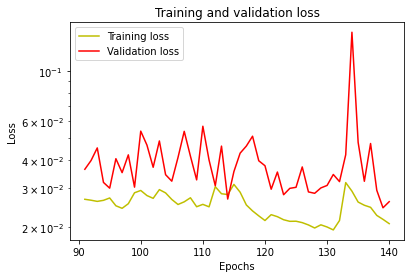

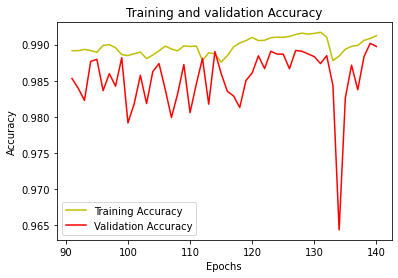

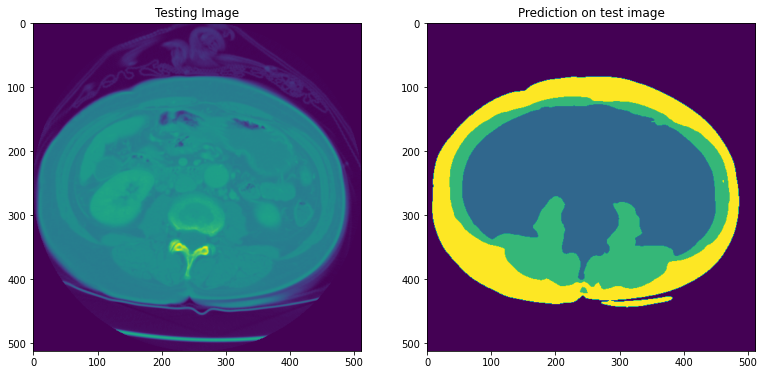

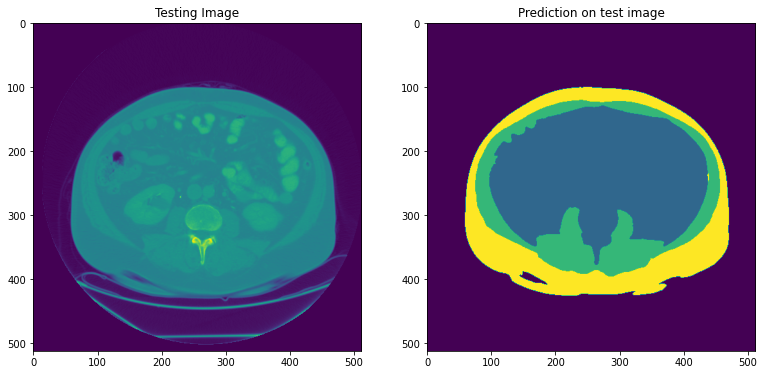

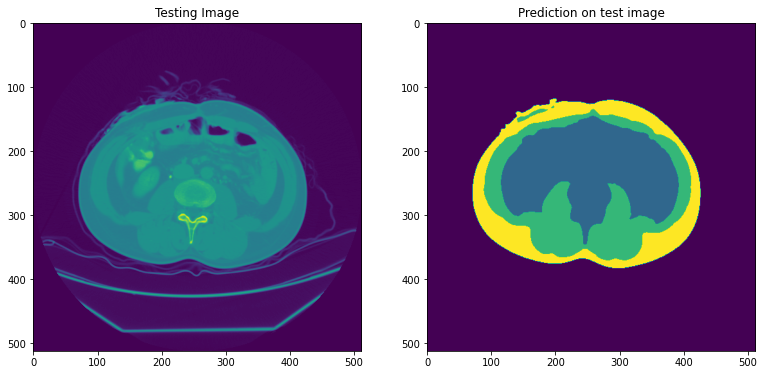

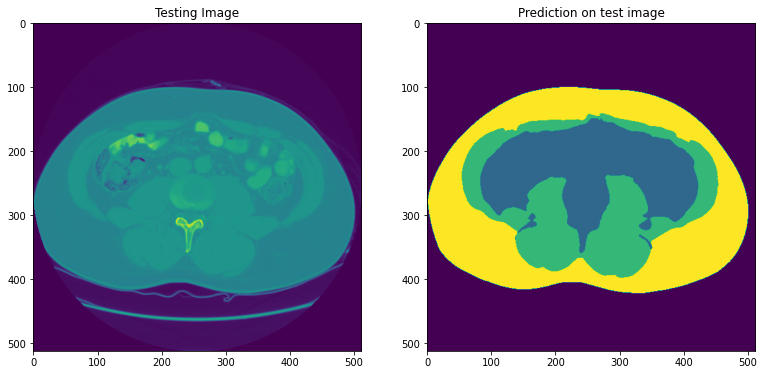

epoch 141:
11/11 [==============================] - 4s 386ms/step - loss: 0.0199 - accuracy: 0.9915 - val_loss: 0.0263 - val_accuracy: 0.9898
139 0.024475552141666412
epoch 142:
11/11 [==============================] - 4s 392ms/step - loss: 0.0206 - accuracy: 0.9912 - val_loss: 0.0270 - val_accuracy: 0.9892
139 0.024475552141666412
epoch 143:
11/11 [==============================] - 4s 388ms/step - loss: 0.0203 - accuracy: 0.9914 - val_loss: 0.0265 - val_accuracy: 0.9897
139 0.024475552141666412
epoch 144:
11/11 [==============================] - 4s 396ms/step - loss: 0.0203 - accuracy: 0.9913 - val_loss: 0.0268 - val_accuracy: 0.9894
139 0.024475552141666412
epoch 145:
11/11 [==============================] - 4s 389ms/step - loss: 0.0207 - accuracy: 0.9913 - val_loss: 0.0296 - val_accuracy: 0.9886
139 0.024475552141666412
epoch 146:
11/11 [==============================] - 4s 387ms/step - loss: 0.0201 - accuracy: 0.9914 - val_loss: 0.0313 - val_accuracy: 0.9882
139 0.02447555214166641

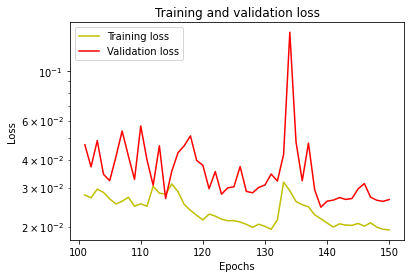

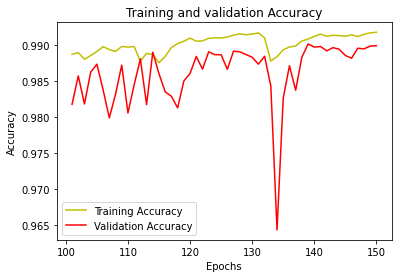

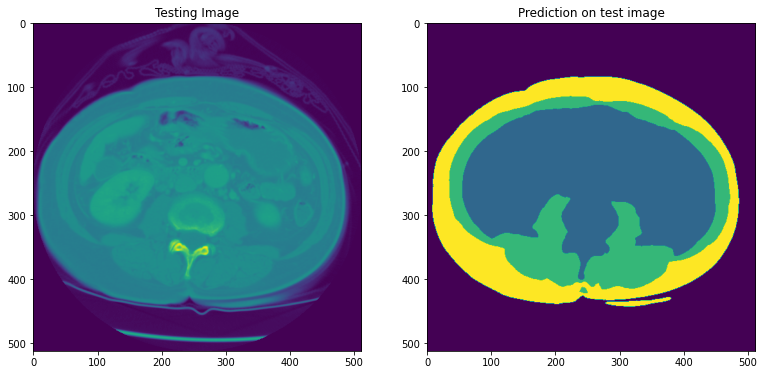

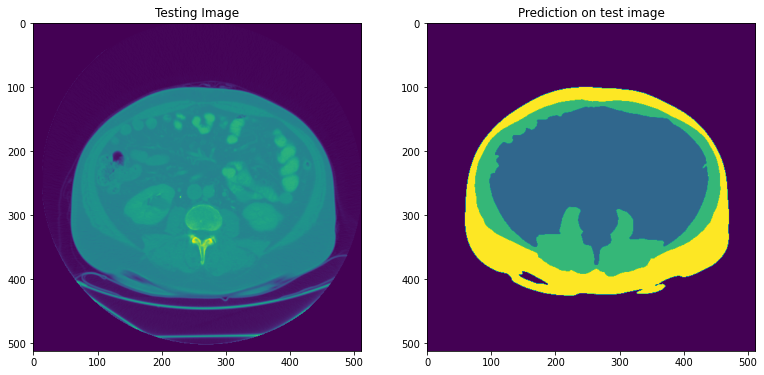

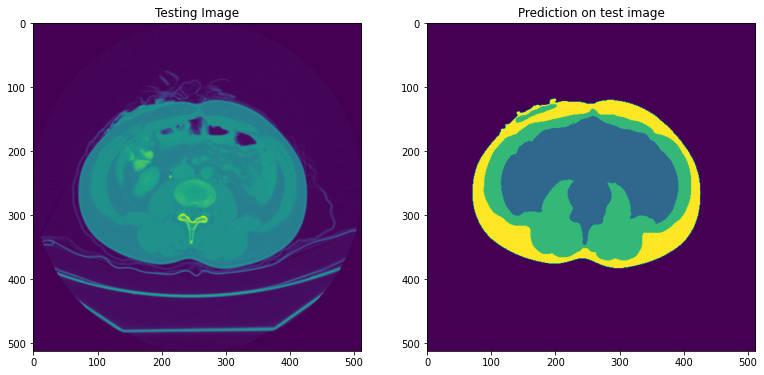

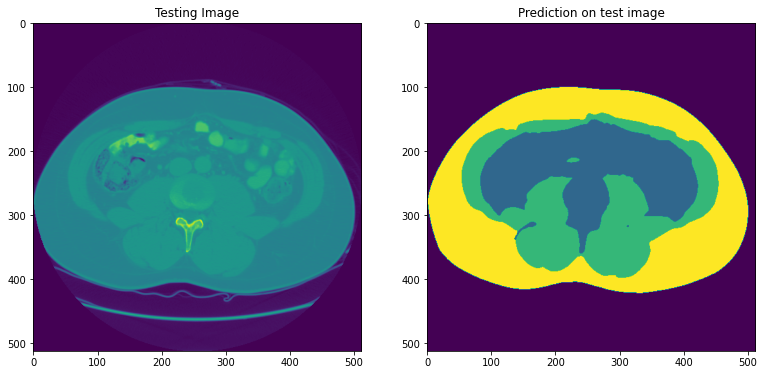

epoch 151:
11/11 [==============================] - 4s 388ms/step - loss: 0.0190 - accuracy: 0.9919 - val_loss: 0.0260 - val_accuracy: 0.9900
139 0.024475552141666412
epoch 152:
11/11 [==============================] - 4s 390ms/step - loss: 0.0198 - accuracy: 0.9915 - val_loss: 0.0262 - val_accuracy: 0.9899
139 0.024475552141666412
epoch 153:
11/11 [==============================] - 4s 389ms/step - loss: 0.0198 - accuracy: 0.9916 - val_loss: 0.0266 - val_accuracy: 0.9899
139 0.024475552141666412
epoch 154:
11/11 [==============================] - 4s 399ms/step - loss: 0.0198 - accuracy: 0.9916 - val_loss: 0.0256 - val_accuracy: 0.9899
139 0.024475552141666412
epoch 155:
11/11 [==============================] - 4s 389ms/step - loss: 0.0191 - accuracy: 0.9919 - val_loss: 0.0255 - val_accuracy: 0.9899
139 0.024475552141666412
epoch 156:
11/11 [==============================] - 4s 386ms/step - loss: 0.0188 - accuracy: 0.9920 - val_loss: 0.0263 - val_accuracy: 0.9898
139 0.02447555214166641

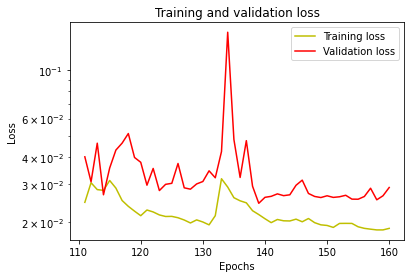

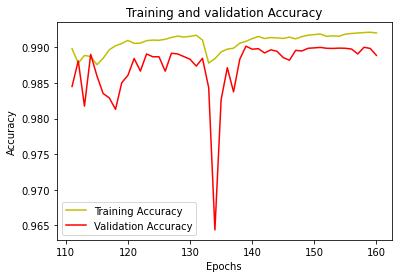

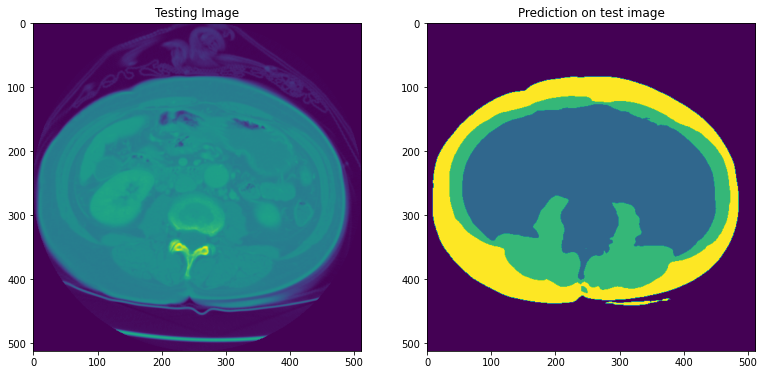

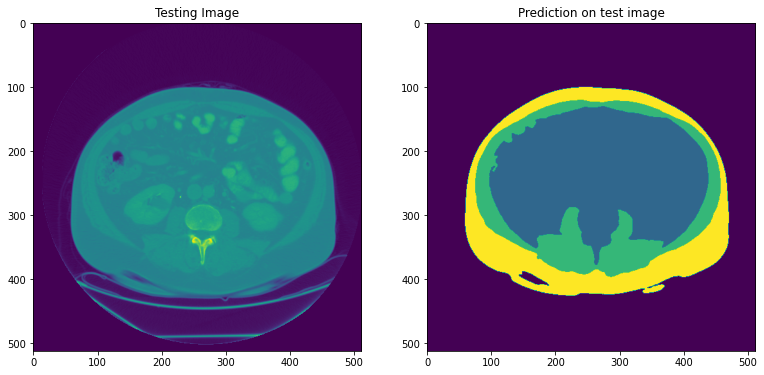

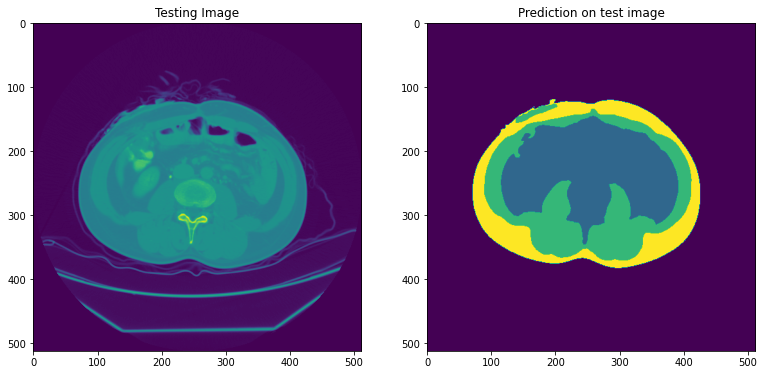

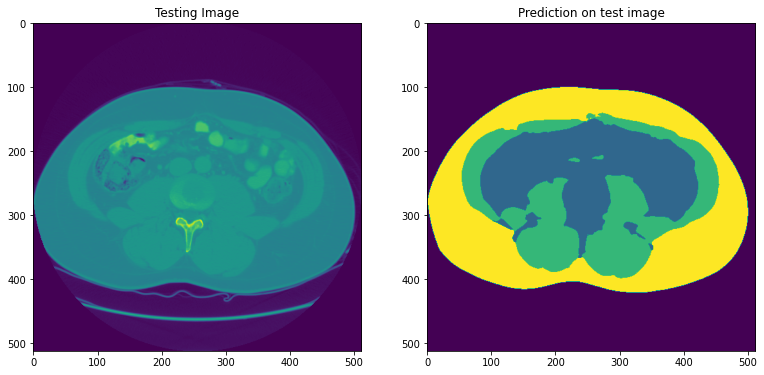

epoch 161:
11/11 [==============================] - 4s 388ms/step - loss: 0.0204 - accuracy: 0.9915 - val_loss: 0.0326 - val_accuracy: 0.9868
139 0.024475552141666412
epoch 162:
11/11 [==============================] - 4s 389ms/step - loss: 0.0190 - accuracy: 0.9919 - val_loss: 0.0303 - val_accuracy: 0.9876
139 0.024475552141666412
epoch 163:
11/11 [==============================] - 4s 389ms/step - loss: 0.0182 - accuracy: 0.9922 - val_loss: 0.0281 - val_accuracy: 0.9884
139 0.024475552141666412
epoch 164:
11/11 [==============================] - 4s 395ms/step - loss: 0.0180 - accuracy: 0.9923 - val_loss: 0.0280 - val_accuracy: 0.9892
139 0.024475552141666412
epoch 165:
11/11 [==============================] - 4s 387ms/step - loss: 0.0184 - accuracy: 0.9921 - val_loss: 0.0255 - val_accuracy: 0.9898
139 0.024475552141666412
epoch 166:
11/11 [==============================] - 4s 390ms/step - loss: 0.0180 - accuracy: 0.9923 - val_loss: 0.0251 - val_accuracy: 0.9900
139 0.02447555214166641

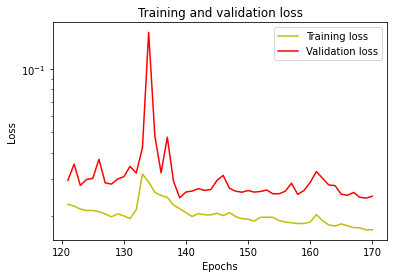

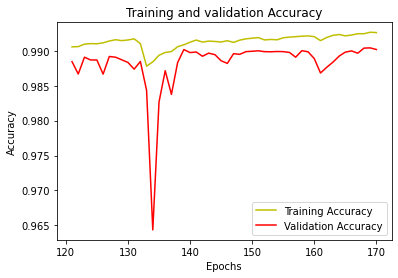

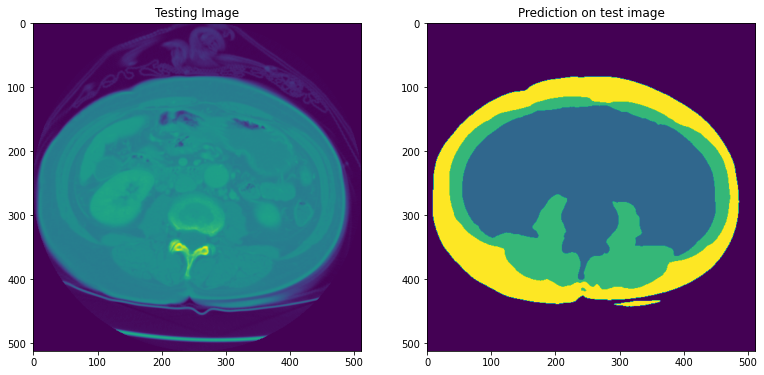

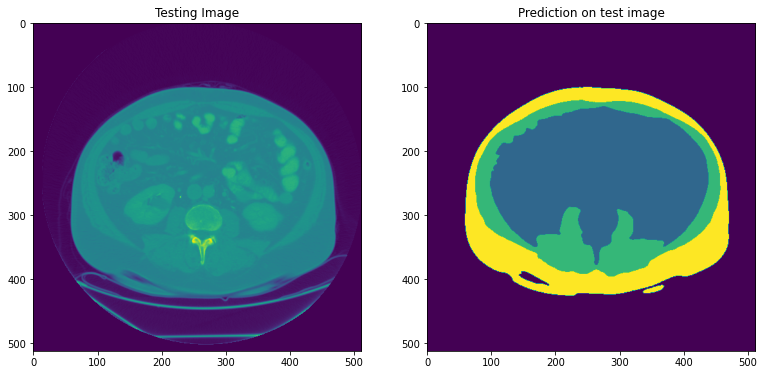

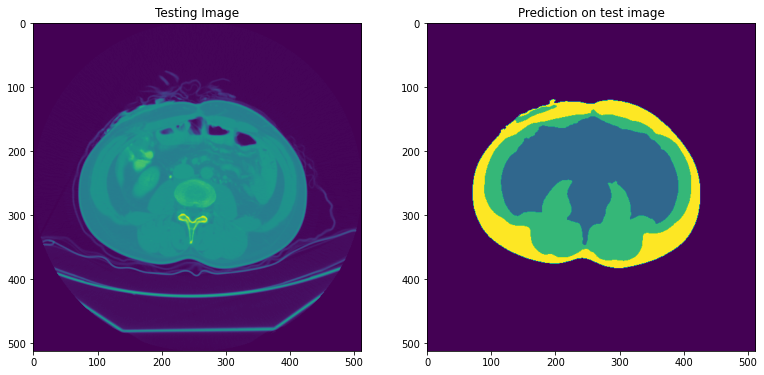

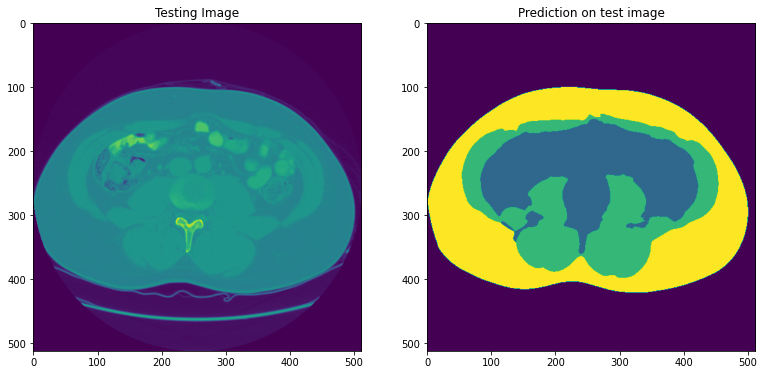

epoch 171:
11/11 [==============================] - 4s 386ms/step - loss: 0.0181 - accuracy: 0.9922 - val_loss: 0.0287 - val_accuracy: 0.9891
169 0.024384889751672745
epoch 172:
11/11 [==============================] - 4s 387ms/step - loss: 0.0175 - accuracy: 0.9925 - val_loss: 0.0274 - val_accuracy: 0.9890
169 0.024384889751672745
epoch 173:
11/11 [==============================] - 4s 388ms/step - loss: 0.0168 - accuracy: 0.9928 - val_loss: 0.0270 - val_accuracy: 0.9896
169 0.024384889751672745
epoch 174:
11/11 [==============================] - 4s 393ms/step - loss: 0.0167 - accuracy: 0.9929 - val_loss: 0.0272 - val_accuracy: 0.9896
169 0.024384889751672745
epoch 175:
11/11 [==============================] - 4s 387ms/step - loss: 0.0166 - accuracy: 0.9929 - val_loss: 0.0287 - val_accuracy: 0.9890
169 0.024384889751672745
epoch 176:
11/11 [==============================] - 4s 387ms/step - loss: 0.0169 - accuracy: 0.9928 - val_loss: 0.0298 - val_accuracy: 0.9888
169 0.02438488975167274

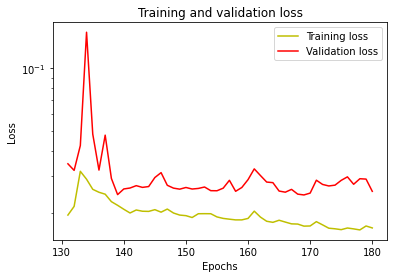

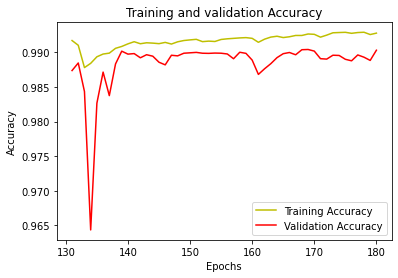

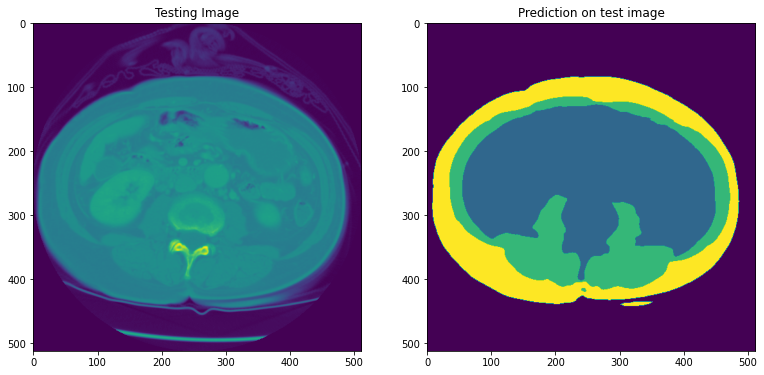

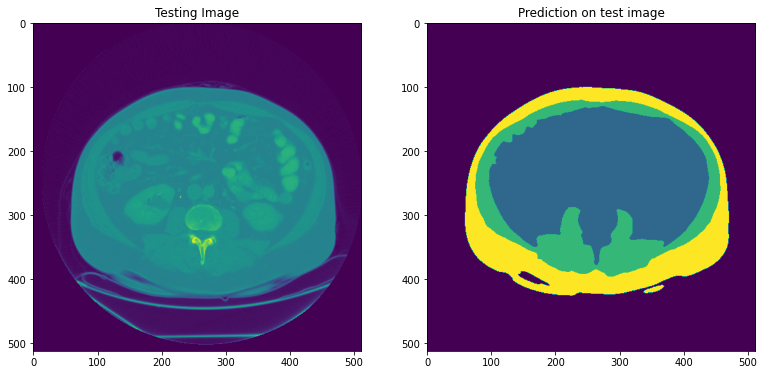

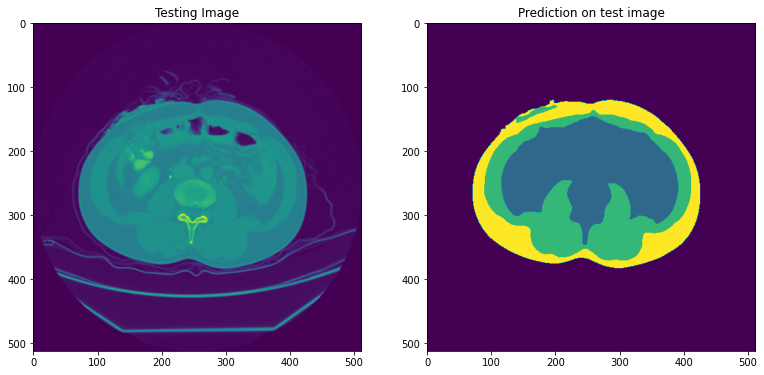

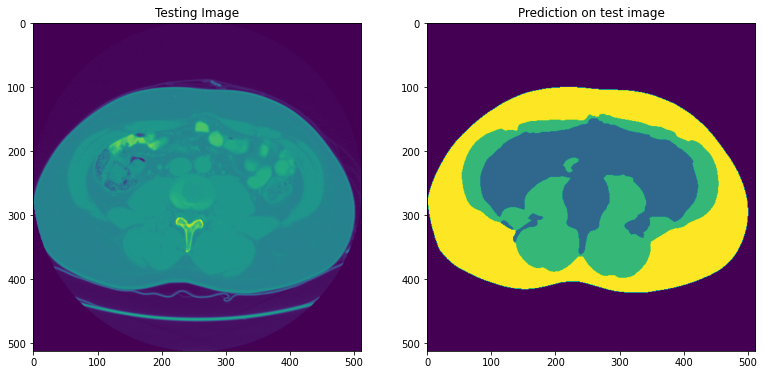

epoch 181:
11/11 [==============================] - 4s 392ms/step - loss: 0.0171 - accuracy: 0.9927 - val_loss: 0.0251 - val_accuracy: 0.9904
169 0.024384889751672745
epoch 182:
11/11 [==============================] - 4s 387ms/step - loss: 0.0169 - accuracy: 0.9928 - val_loss: 0.0262 - val_accuracy: 0.9901
169 0.024384889751672745
epoch 183:
11/11 [==============================] - 4s 386ms/step - loss: 0.0163 - accuracy: 0.9930 - val_loss: 0.0270 - val_accuracy: 0.9897
169 0.024384889751672745
epoch 184:
11/11 [==============================] - 4s 397ms/step - loss: 0.0160 - accuracy: 0.9931 - val_loss: 0.0290 - val_accuracy: 0.9893
169 0.024384889751672745
epoch 185:
11/11 [==============================] - 4s 391ms/step - loss: 0.0163 - accuracy: 0.9930 - val_loss: 0.0268 - val_accuracy: 0.9900
169 0.024384889751672745
epoch 186:
11/11 [==============================] - 4s 388ms/step - loss: 0.0160 - accuracy: 0.9931 - val_loss: 0.0265 - val_accuracy: 0.9903
169 0.02438488975167274

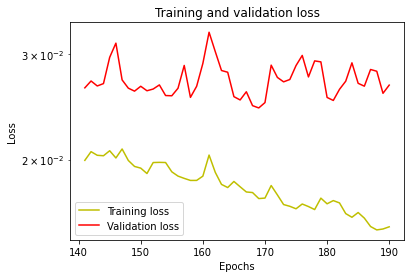

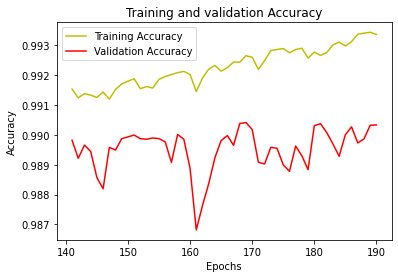

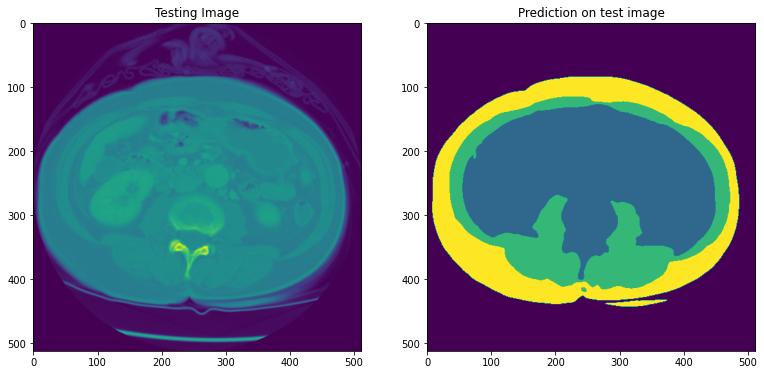

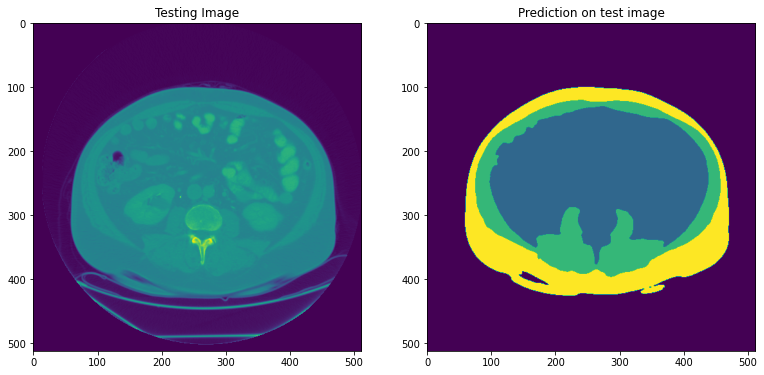

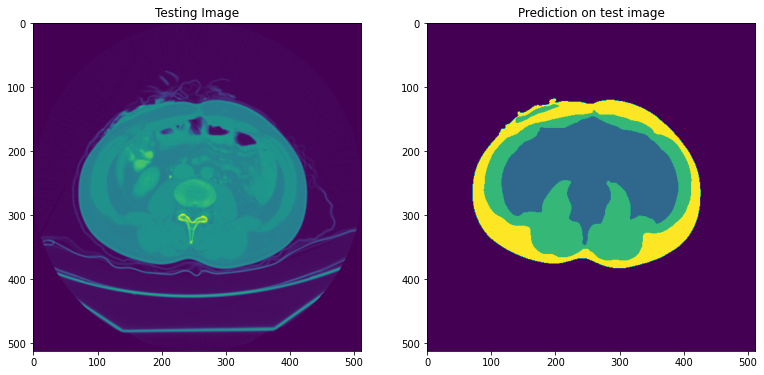

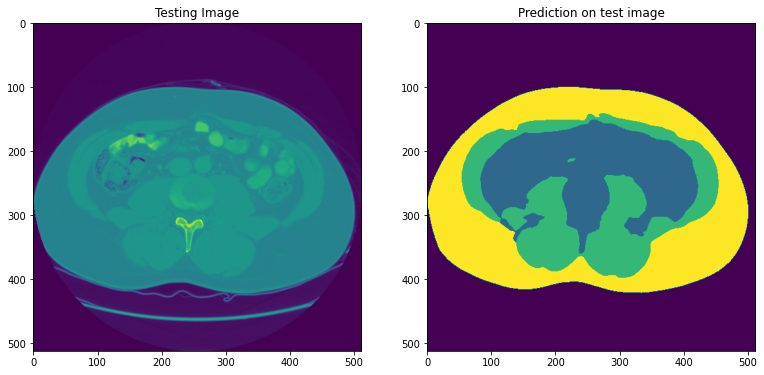

epoch 191:
11/11 [==============================] - 4s 388ms/step - loss: 0.0151 - accuracy: 0.9935 - val_loss: 0.0266 - val_accuracy: 0.9902
169 0.024384889751672745
epoch 192:
11/11 [==============================] - 4s 388ms/step - loss: 0.0149 - accuracy: 0.9936 - val_loss: 0.0283 - val_accuracy: 0.9898
169 0.024384889751672745
epoch 193:
11/11 [==============================] - 4s 391ms/step - loss: 0.0150 - accuracy: 0.9935 - val_loss: 0.0274 - val_accuracy: 0.9900
169 0.024384889751672745
epoch 194:
11/11 [==============================] - 4s 397ms/step - loss: 0.0164 - accuracy: 0.9930 - val_loss: 0.0305 - val_accuracy: 0.9889
169 0.024384889751672745
epoch 195:
11/11 [==============================] - 4s 388ms/step - loss: 0.0165 - accuracy: 0.9929 - val_loss: 0.0289 - val_accuracy: 0.9892
169 0.024384889751672745
epoch 196:
11/11 [==============================] - 4s 386ms/step - loss: 0.0157 - accuracy: 0.9932 - val_loss: 0.0273 - val_accuracy: 0.9902
169 0.02438488975167274

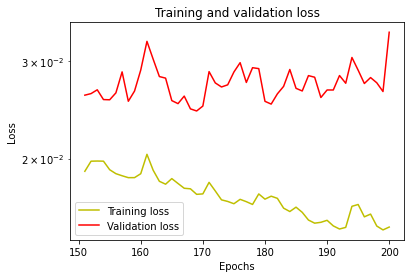

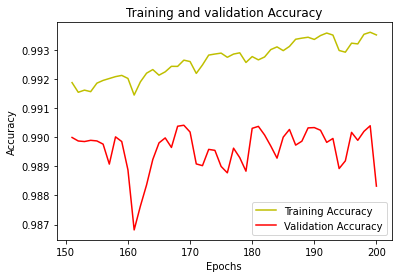

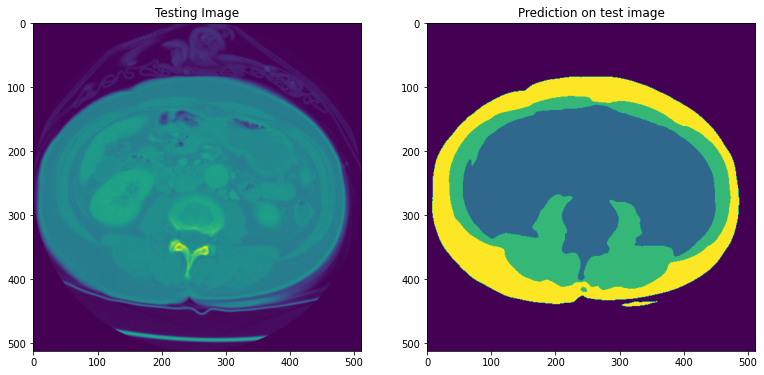

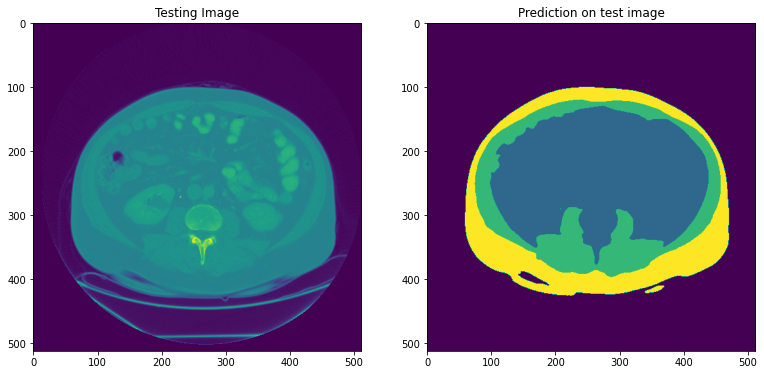

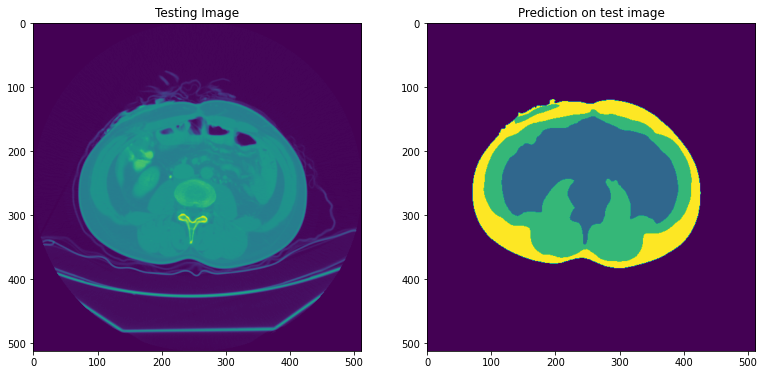

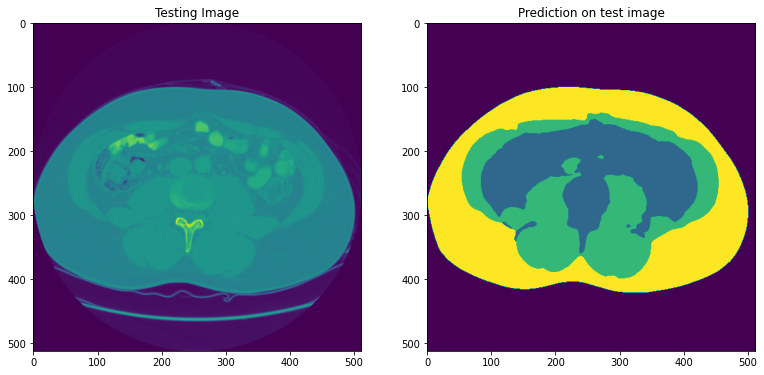

epoch 201:
11/11 [==============================] - 4s 389ms/step - loss: 0.0145 - accuracy: 0.9938 - val_loss: 0.0285 - val_accuracy: 0.9899
169 0.024384889751672745
epoch 202:
11/11 [==============================] - 4s 388ms/step - loss: 0.0145 - accuracy: 0.9938 - val_loss: 0.0279 - val_accuracy: 0.9900
169 0.024384889751672745
epoch 203:
11/11 [==============================] - 4s 393ms/step - loss: 0.0143 - accuracy: 0.9939 - val_loss: 0.0280 - val_accuracy: 0.9899
169 0.024384889751672745
epoch 204:
11/11 [==============================] - 4s 393ms/step - loss: 0.0145 - accuracy: 0.9938 - val_loss: 0.0287 - val_accuracy: 0.9901
169 0.024384889751672745
epoch 205:
11/11 [==============================] - 4s 390ms/step - loss: 0.0147 - accuracy: 0.9937 - val_loss: 0.0281 - val_accuracy: 0.9901
169 0.024384889751672745
epoch 206:
11/11 [==============================] - 4s 388ms/step - loss: 0.0145 - accuracy: 0.9938 - val_loss: 0.0267 - val_accuracy: 0.9906
169 0.02438488975167274

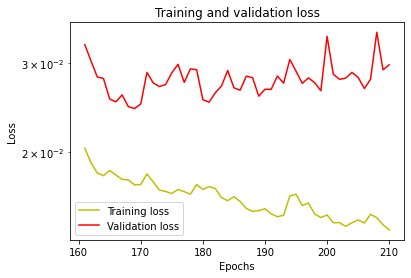

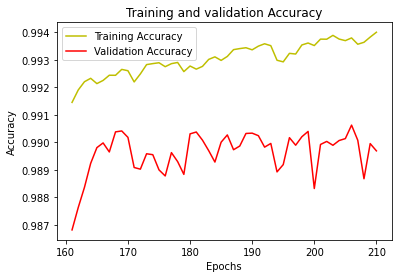

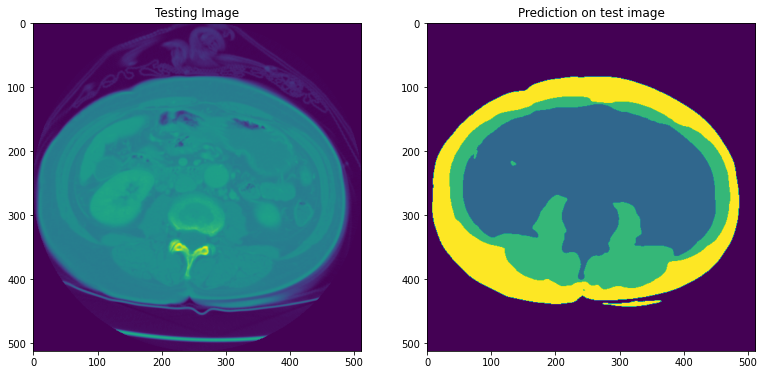

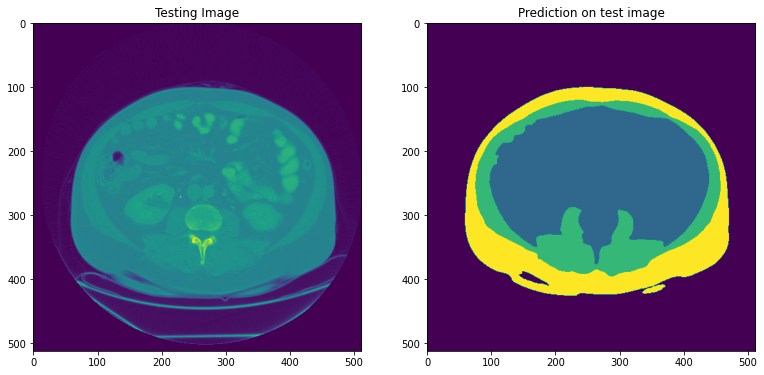

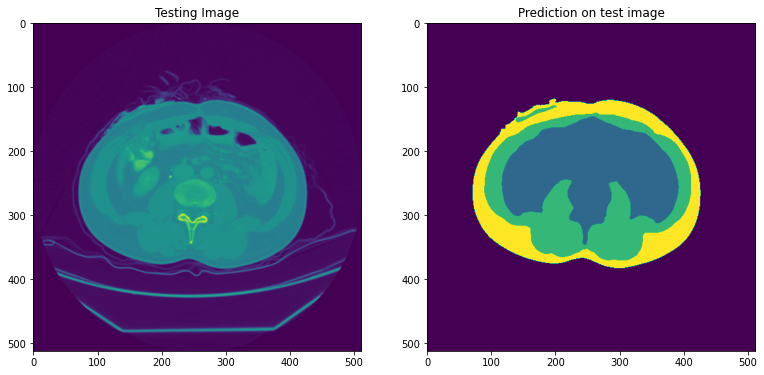

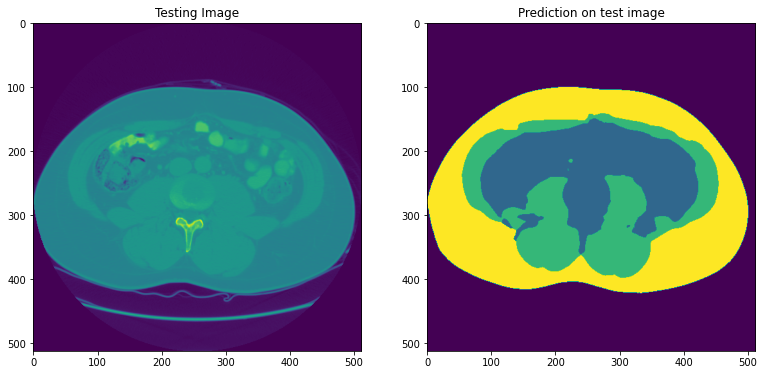

epoch 211:
11/11 [==============================] - 4s 389ms/step - loss: 0.0135 - accuracy: 0.9942 - val_loss: 0.0298 - val_accuracy: 0.9897
169 0.024384889751672745
epoch 212:
11/11 [==============================] - 4s 388ms/step - loss: 0.0137 - accuracy: 0.9941 - val_loss: 0.0290 - val_accuracy: 0.9899
169 0.024384889751672745
epoch 213:
11/11 [==============================] - 4s 393ms/step - loss: 0.0138 - accuracy: 0.9941 - val_loss: 0.0273 - val_accuracy: 0.9901
169 0.024384889751672745
epoch 214:
11/11 [==============================] - 4s 395ms/step - loss: 0.0139 - accuracy: 0.9941 - val_loss: 0.0310 - val_accuracy: 0.9898
169 0.024384889751672745
epoch 215:
11/11 [==============================] - 4s 389ms/step - loss: 0.0142 - accuracy: 0.9939 - val_loss: 0.0323 - val_accuracy: 0.9895
169 0.024384889751672745
epoch 216:
11/11 [==============================] - 4s 387ms/step - loss: 0.0141 - accuracy: 0.9939 - val_loss: 0.0284 - val_accuracy: 0.9901
169 0.02438488975167274

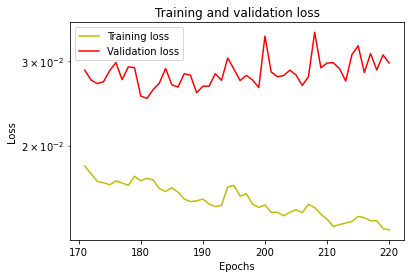

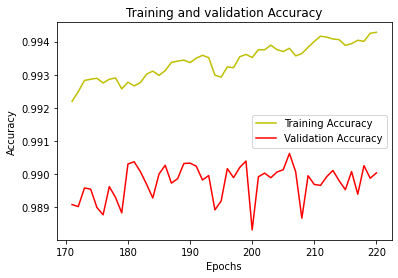

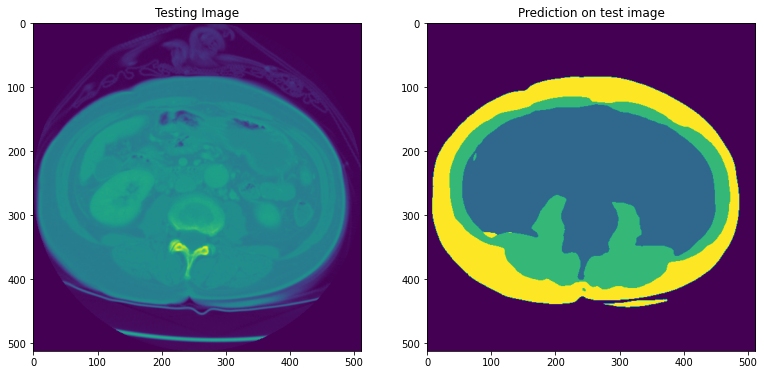

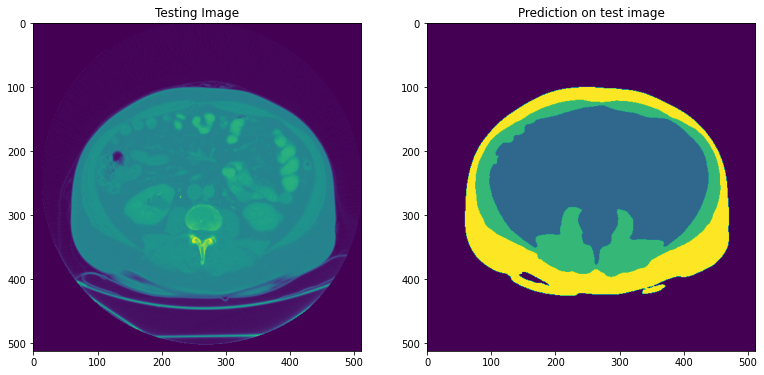

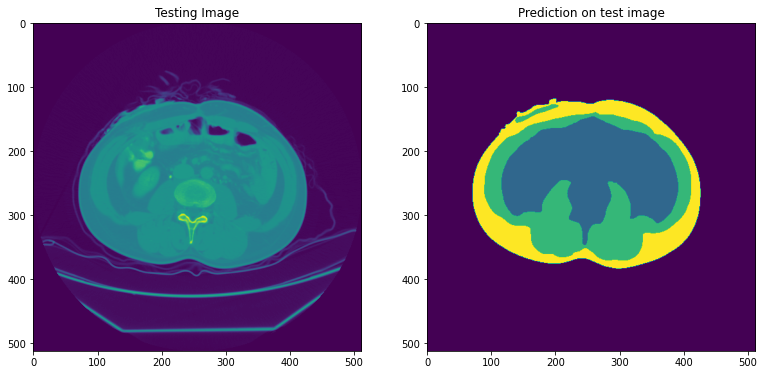

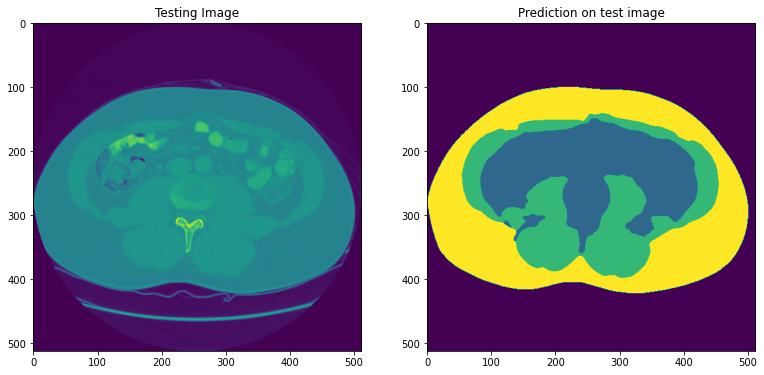

epoch 221:
11/11 [==============================] - 4s 388ms/step - loss: 0.0141 - accuracy: 0.9940 - val_loss: 0.0294 - val_accuracy: 0.9897
169 0.024384889751672745
epoch 222:
11/11 [==============================] - 4s 387ms/step - loss: 0.0144 - accuracy: 0.9938 - val_loss: 0.0335 - val_accuracy: 0.9886
169 0.024384889751672745
epoch 223:
11/11 [==============================] - 4s 393ms/step - loss: 0.0139 - accuracy: 0.9941 - val_loss: 0.0311 - val_accuracy: 0.9896
169 0.024384889751672745
epoch 224:
11/11 [==============================] - 4s 399ms/step - loss: 0.0139 - accuracy: 0.9941 - val_loss: 0.0325 - val_accuracy: 0.9892
169 0.024384889751672745
epoch 225:
11/11 [==============================] - 4s 389ms/step - loss: 0.0141 - accuracy: 0.9940 - val_loss: 0.0363 - val_accuracy: 0.9880
169 0.024384889751672745
epoch 226:
11/11 [==============================] - 4s 390ms/step - loss: 0.0166 - accuracy: 0.9930 - val_loss: 0.0387 - val_accuracy: 0.9878
169 0.02438488975167274

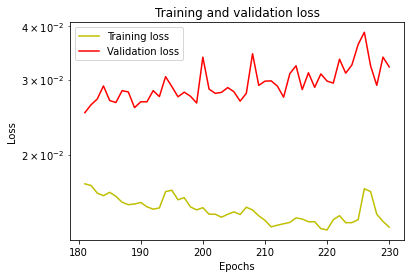

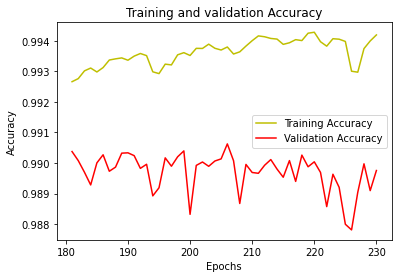

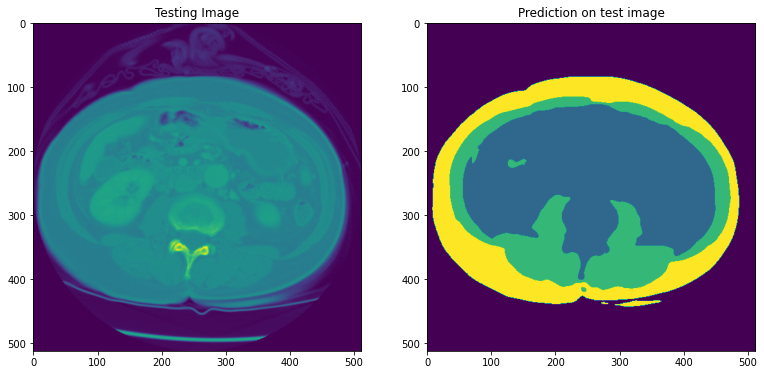

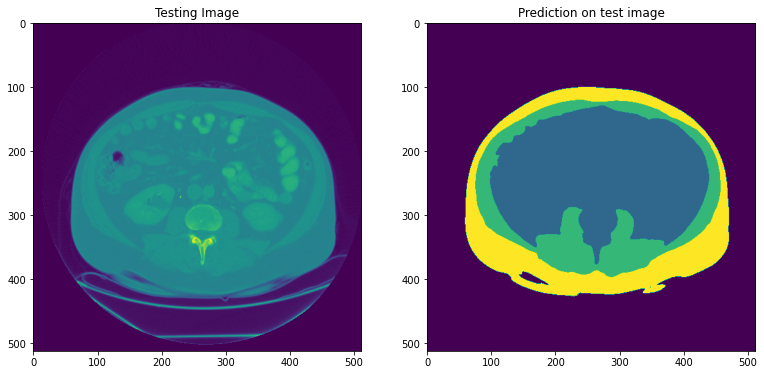

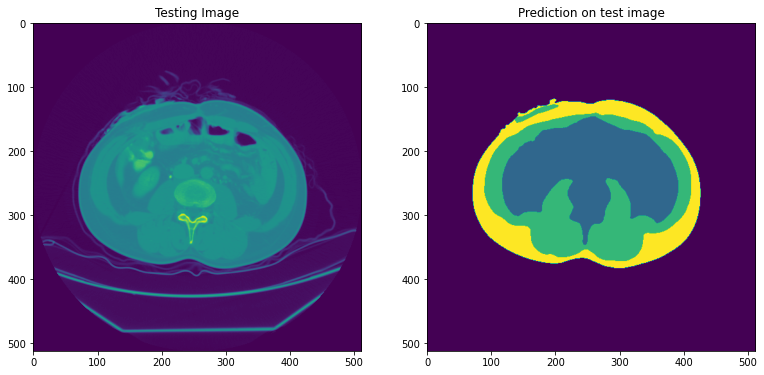

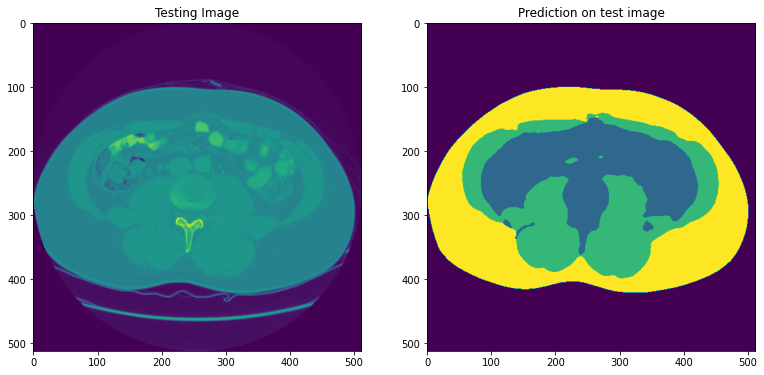

epoch 231:
11/11 [==============================] - 4s 388ms/step - loss: 0.0130 - accuracy: 0.9944 - val_loss: 0.0303 - val_accuracy: 0.9901
169 0.024384889751672745
epoch 232:
11/11 [==============================] - 4s 390ms/step - loss: 0.0128 - accuracy: 0.9945 - val_loss: 0.0318 - val_accuracy: 0.9900
169 0.024384889751672745
epoch 233:
11/11 [==============================] - 4s 399ms/step - loss: 0.0126 - accuracy: 0.9946 - val_loss: 0.0328 - val_accuracy: 0.9899
169 0.024384889751672745
epoch 234:
11/11 [==============================] - 4s 390ms/step - loss: 0.0126 - accuracy: 0.9946 - val_loss: 0.0326 - val_accuracy: 0.9897
169 0.024384889751672745
epoch 235:
11/11 [==============================] - 4s 389ms/step - loss: 0.0127 - accuracy: 0.9945 - val_loss: 0.0337 - val_accuracy: 0.9892
169 0.024384889751672745
epoch 236:
11/11 [==============================] - 4s 386ms/step - loss: 0.0127 - accuracy: 0.9945 - val_loss: 0.0325 - val_accuracy: 0.9898
169 0.02438488975167274

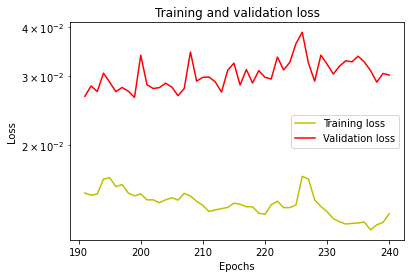

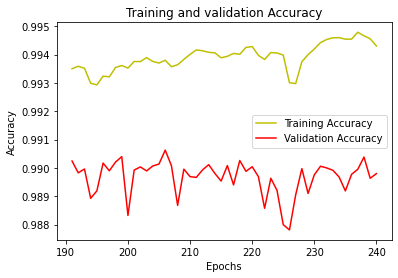

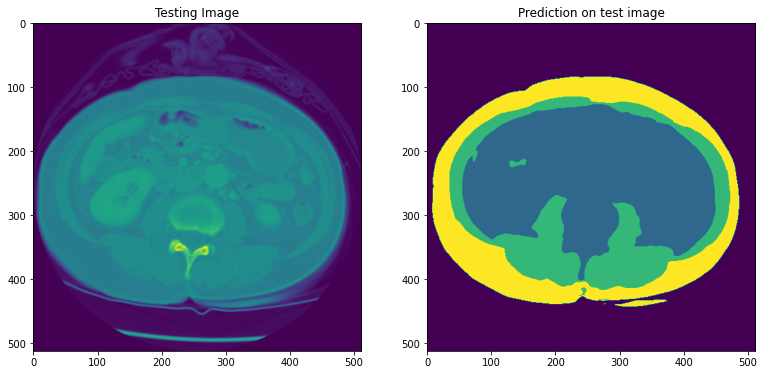

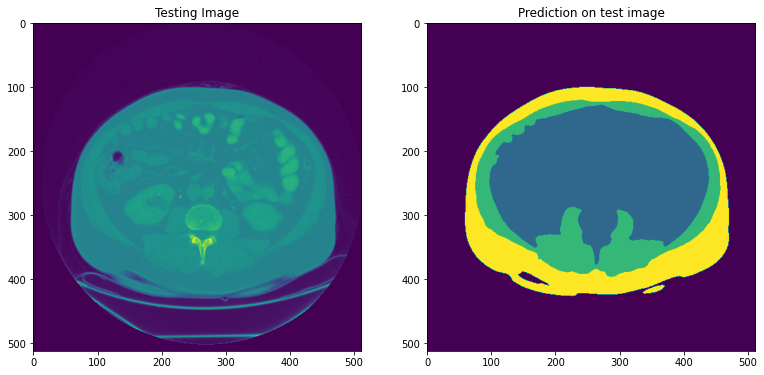

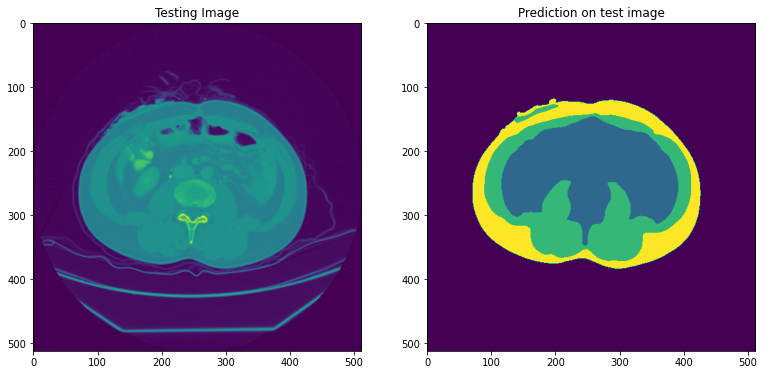

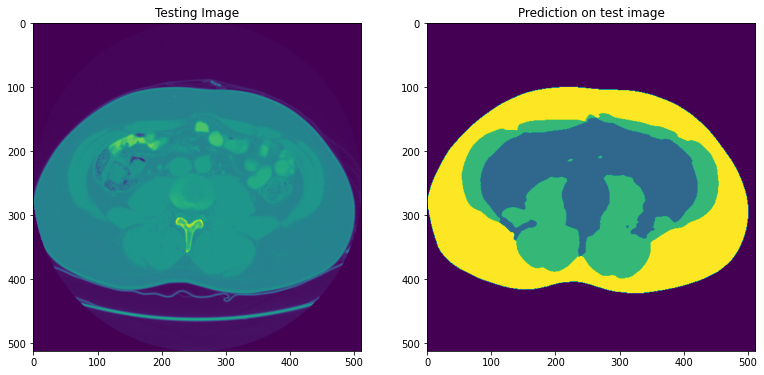

epoch 241:
11/11 [==============================] - 4s 386ms/step - loss: 0.0128 - accuracy: 0.9945 - val_loss: 0.0293 - val_accuracy: 0.9902
169 0.024384889751672745
epoch 242:
11/11 [==============================] - 4s 393ms/step - loss: 0.0120 - accuracy: 0.9949 - val_loss: 0.0309 - val_accuracy: 0.9901
169 0.024384889751672745
epoch 243:
11/11 [==============================] - 4s 391ms/step - loss: 0.0117 - accuracy: 0.9950 - val_loss: 0.0327 - val_accuracy: 0.9900
169 0.024384889751672745
epoch 244:
11/11 [==============================] - 4s 399ms/step - loss: 0.0123 - accuracy: 0.9948 - val_loss: 0.0343 - val_accuracy: 0.9895
169 0.024384889751672745
epoch 245:
11/11 [==============================] - 4s 387ms/step - loss: 0.0122 - accuracy: 0.9948 - val_loss: 0.0330 - val_accuracy: 0.9896
169 0.024384889751672745
epoch 246:
11/11 [==============================] - 4s 392ms/step - loss: 0.0125 - accuracy: 0.9947 - val_loss: 0.0306 - val_accuracy: 0.9903
169 0.02438488975167274

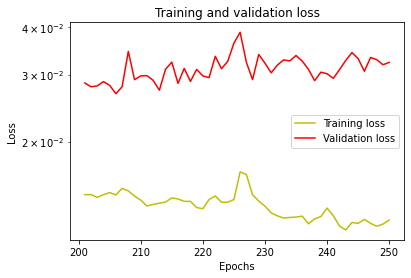

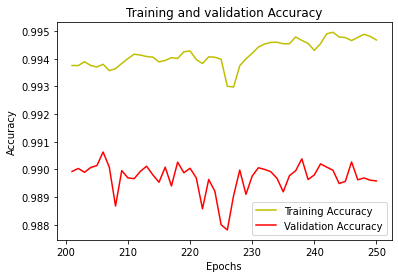

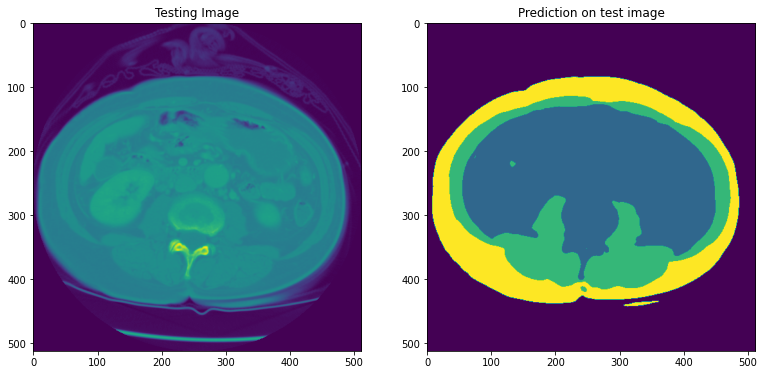

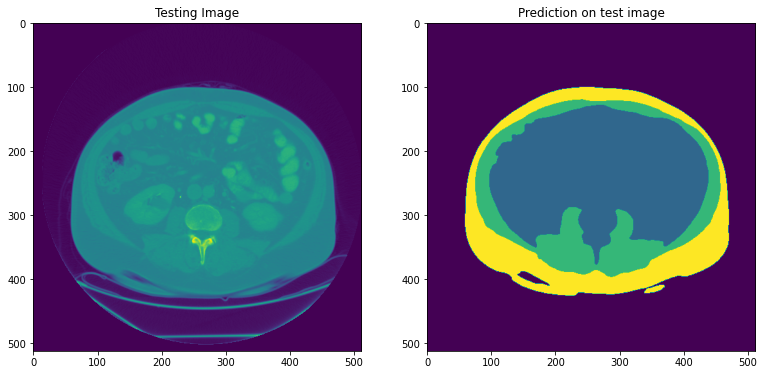

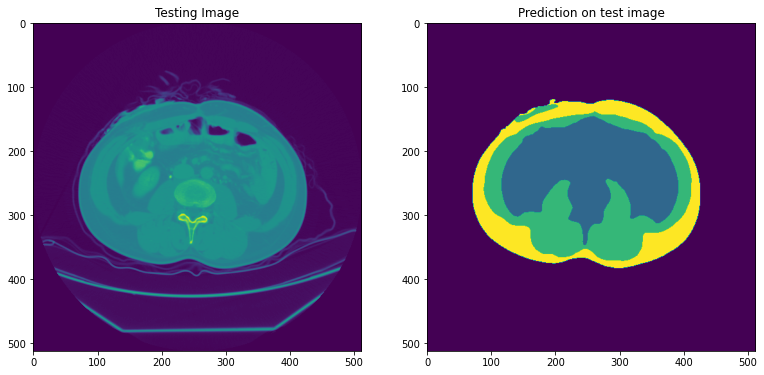

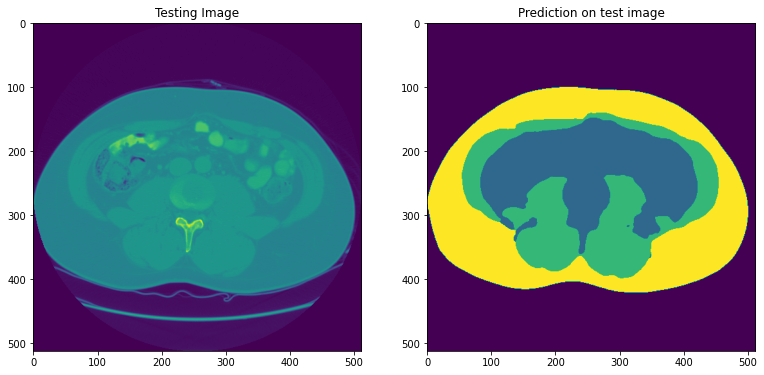

epoch 251:
11/11 [==============================] - 4s 388ms/step - loss: 0.0133 - accuracy: 0.9943 - val_loss: 0.0426 - val_accuracy: 0.9877
169 0.024384889751672745
epoch 252:
11/11 [==============================] - 4s 391ms/step - loss: 0.0129 - accuracy: 0.9945 - val_loss: 0.0346 - val_accuracy: 0.9888
169 0.024384889751672745
epoch 253:
11/11 [==============================] - 4s 391ms/step - loss: 0.0122 - accuracy: 0.9948 - val_loss: 0.0311 - val_accuracy: 0.9901
169 0.024384889751672745
epoch 254:
11/11 [==============================] - 4s 397ms/step - loss: 0.0116 - accuracy: 0.9950 - val_loss: 0.0346 - val_accuracy: 0.9895
169 0.024384889751672745
epoch 255:
11/11 [==============================] - 4s 389ms/step - loss: 0.0113 - accuracy: 0.9951 - val_loss: 0.0312 - val_accuracy: 0.9903
169 0.024384889751672745
epoch 256:
11/11 [==============================] - 4s 392ms/step - loss: 0.0109 - accuracy: 0.9954 - val_loss: 0.0313 - val_accuracy: 0.9902
169 0.02438488975167274

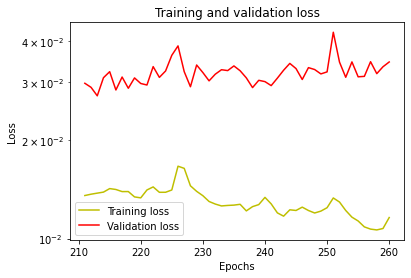

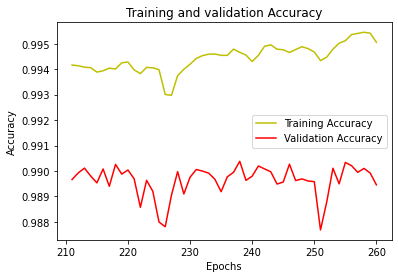

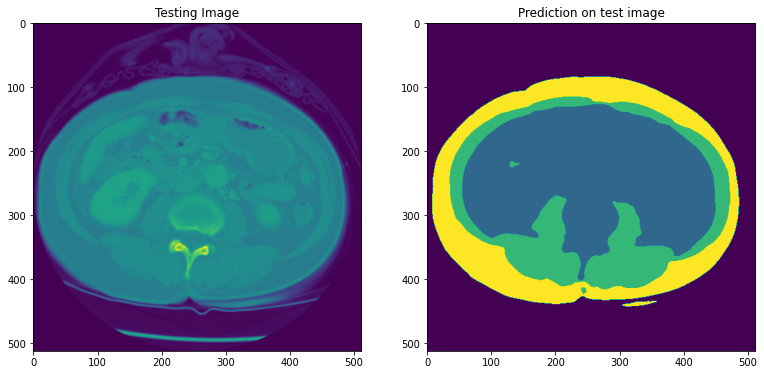

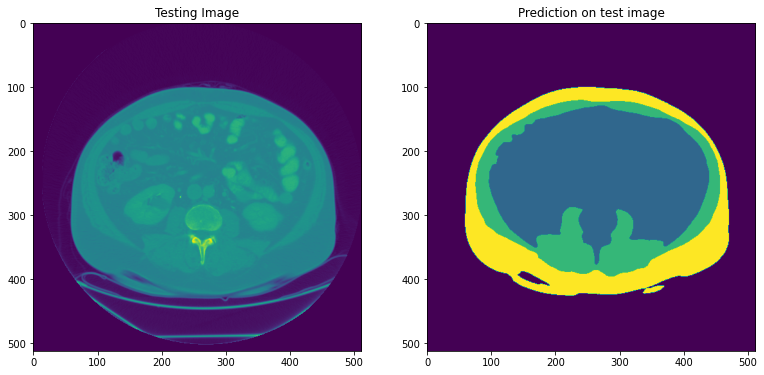

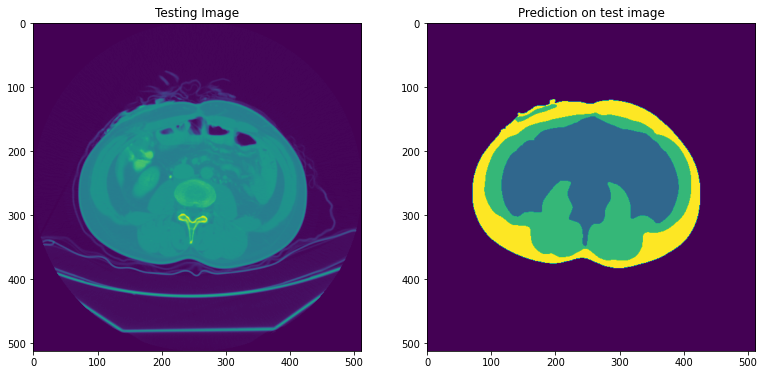

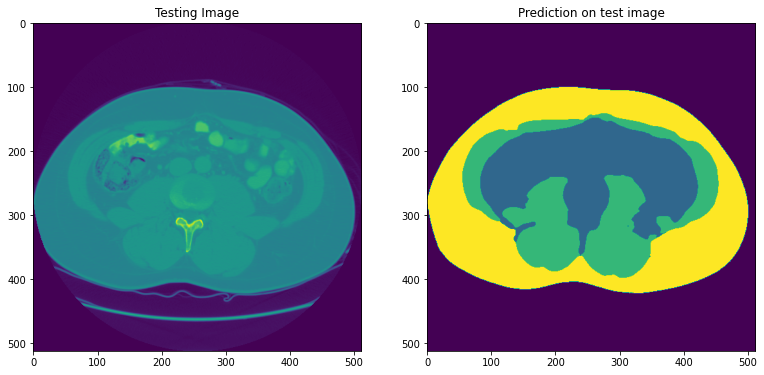

epoch 261:
11/11 [==============================] - 4s 388ms/step - loss: 0.0114 - accuracy: 0.9951 - val_loss: 0.0342 - val_accuracy: 0.9895
169 0.024384889751672745
epoch 262:
11/11 [==============================] - 4s 391ms/step - loss: 0.0111 - accuracy: 0.9953 - val_loss: 0.0344 - val_accuracy: 0.9895
169 0.024384889751672745
epoch 263:
11/11 [==============================] - 4s 391ms/step - loss: 0.0110 - accuracy: 0.9953 - val_loss: 0.0362 - val_accuracy: 0.9894
169 0.024384889751672745
epoch 264:
11/11 [==============================] - 4s 396ms/step - loss: 0.0119 - accuracy: 0.9949 - val_loss: 0.0379 - val_accuracy: 0.9890
169 0.024384889751672745
epoch 265:
11/11 [==============================] - 4s 388ms/step - loss: 0.0127 - accuracy: 0.9946 - val_loss: 0.0383 - val_accuracy: 0.9892
169 0.024384889751672745
epoch 266:
11/11 [==============================] - 4s 387ms/step - loss: 0.0132 - accuracy: 0.9943 - val_loss: 0.0335 - val_accuracy: 0.9893
169 0.02438488975167274

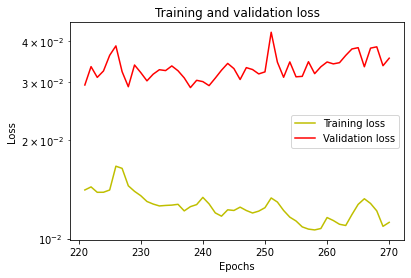

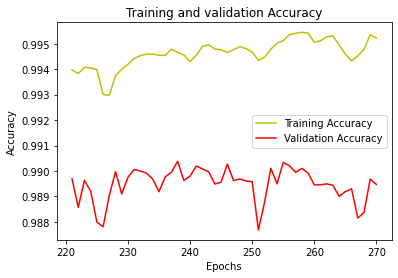

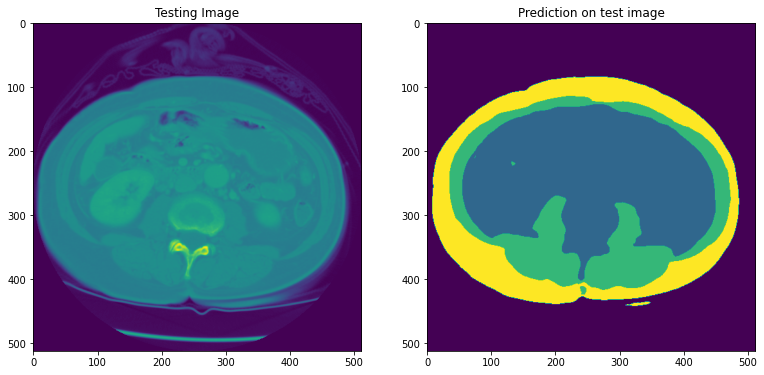

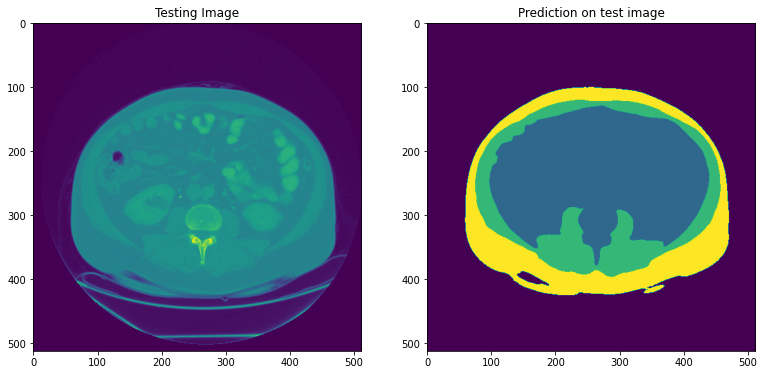

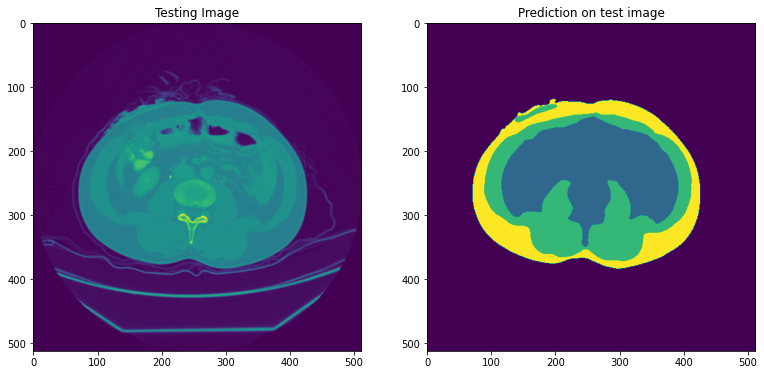

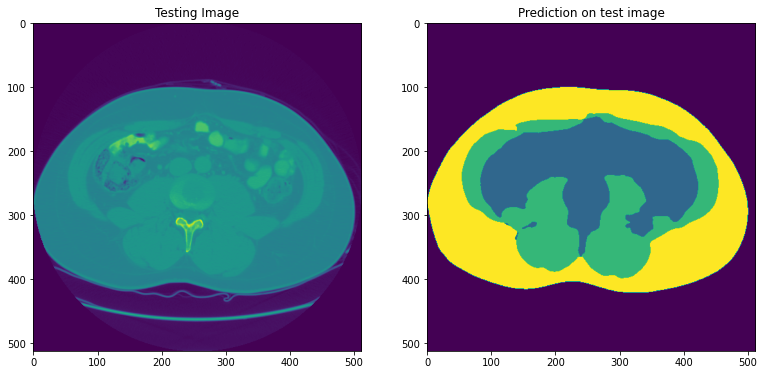

epoch 271:
11/11 [==============================] - 4s 387ms/step - loss: 0.0118 - accuracy: 0.9949 - val_loss: 0.0338 - val_accuracy: 0.9894
169 0.024384889751672745
epoch 272:
11/11 [==============================] - 4s 393ms/step - loss: 0.0110 - accuracy: 0.9952 - val_loss: 0.0323 - val_accuracy: 0.9899
169 0.024384889751672745
epoch 273:
11/11 [==============================] - 4s 394ms/step - loss: 0.0102 - accuracy: 0.9956 - val_loss: 0.0355 - val_accuracy: 0.9895
169 0.024384889751672745
epoch 274:
11/11 [==============================] - 5s 428ms/step - loss: 0.0097 - accuracy: 0.9958 - val_loss: 0.0342 - val_accuracy: 0.9899
169 0.024384889751672745
epoch 275:
11/11 [==============================] - 4s 388ms/step - loss: 0.0095 - accuracy: 0.9959 - val_loss: 0.0345 - val_accuracy: 0.9901
169 0.024384889751672745
epoch 276:
11/11 [==============================] - 4s 389ms/step - loss: 0.0105 - accuracy: 0.9955 - val_loss: 0.0478 - val_accuracy: 0.9865
169 0.02438488975167274

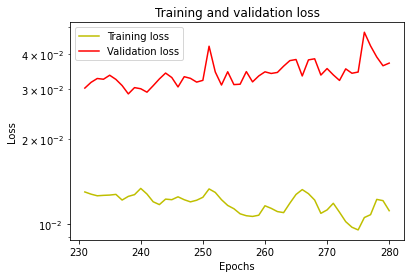

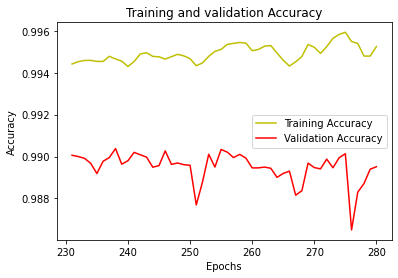

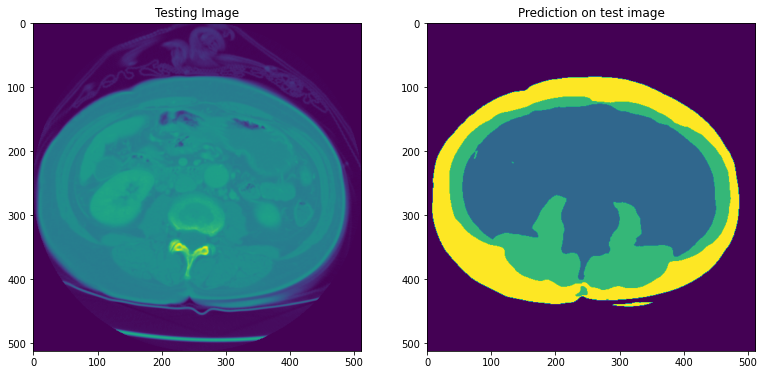

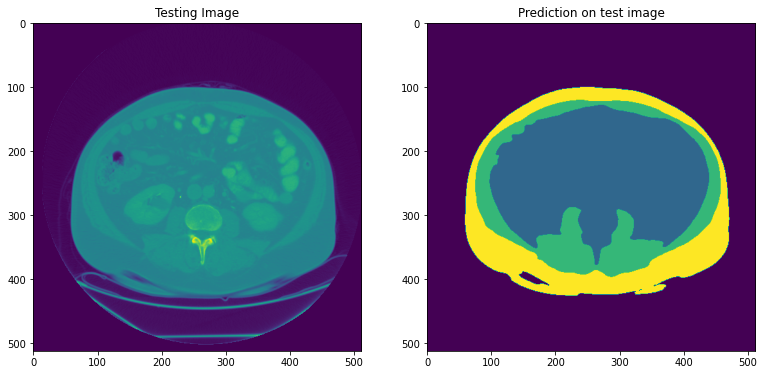

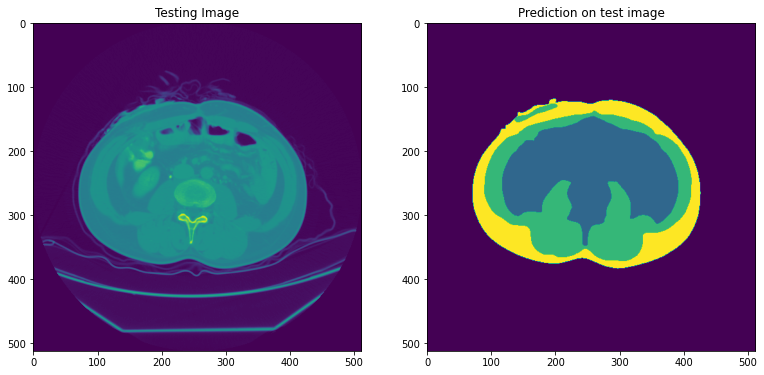

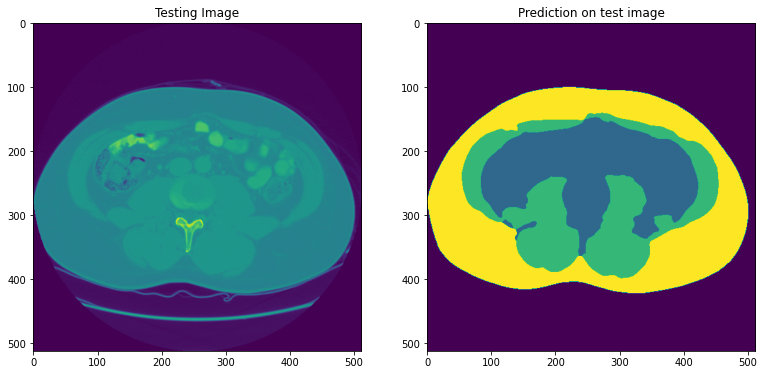

epoch 281:
11/11 [==============================] - 4s 385ms/step - loss: 0.0106 - accuracy: 0.9955 - val_loss: 0.0373 - val_accuracy: 0.9897
169 0.024384889751672745
epoch 282:
11/11 [==============================] - 4s 391ms/step - loss: 0.0109 - accuracy: 0.9953 - val_loss: 0.0338 - val_accuracy: 0.9900
169 0.024384889751672745
epoch 283:
11/11 [==============================] - 4s 387ms/step - loss: 0.0103 - accuracy: 0.9956 - val_loss: 0.0358 - val_accuracy: 0.9897
169 0.024384889751672745
epoch 284:
11/11 [==============================] - 4s 405ms/step - loss: 0.0098 - accuracy: 0.9959 - val_loss: 0.0351 - val_accuracy: 0.9900
169 0.024384889751672745
epoch 285:
11/11 [==============================] - 4s 387ms/step - loss: 0.0095 - accuracy: 0.9959 - val_loss: 0.0343 - val_accuracy: 0.9901
169 0.024384889751672745
epoch 286:
11/11 [==============================] - 4s 389ms/step - loss: 0.0094 - accuracy: 0.9960 - val_loss: 0.0350 - val_accuracy: 0.9902
169 0.02438488975167274

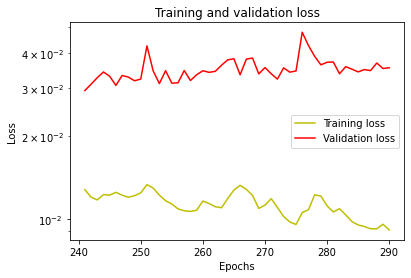

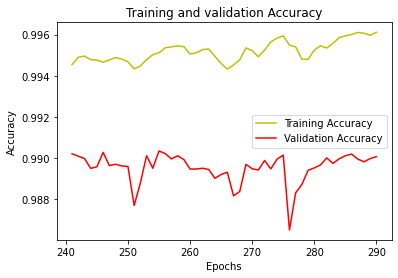

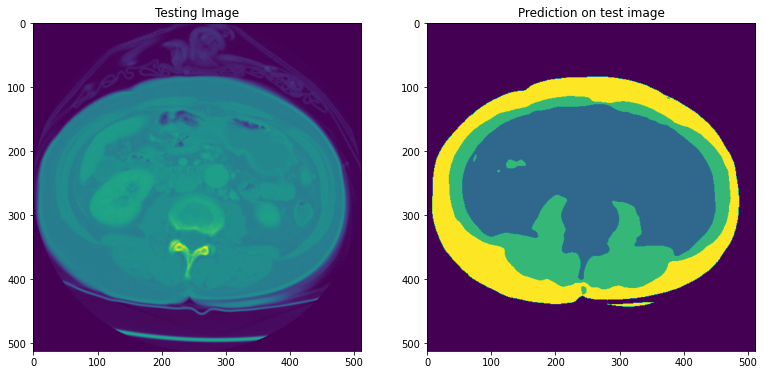

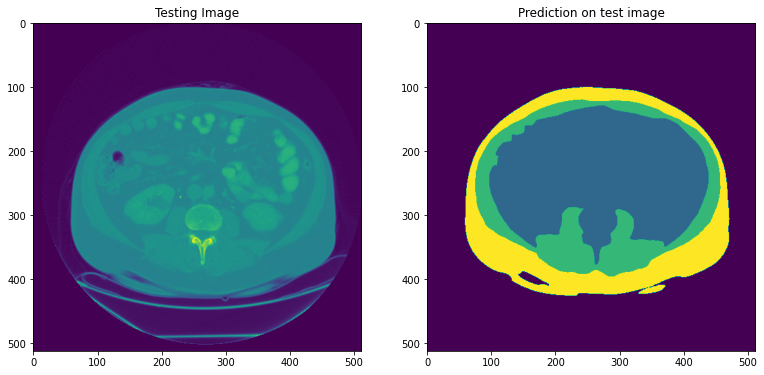

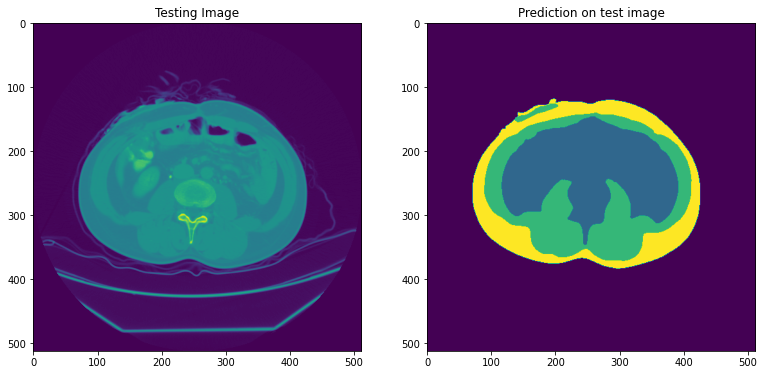

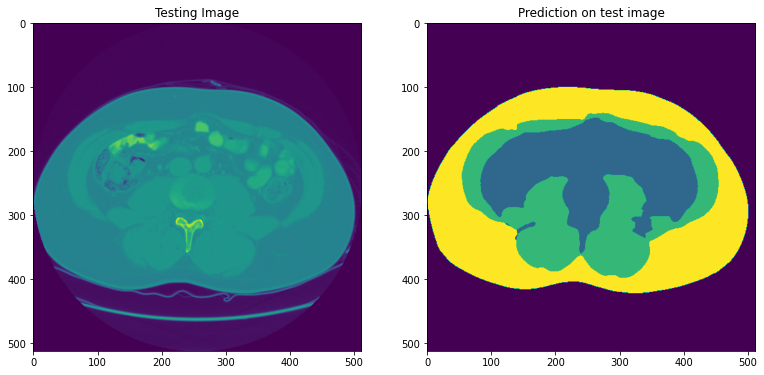

epoch 291:
11/11 [==============================] - 4s 388ms/step - loss: 0.0090 - accuracy: 0.9962 - val_loss: 0.0369 - val_accuracy: 0.9899
169 0.024384889751672745
epoch 292:
11/11 [==============================] - 4s 386ms/step - loss: 0.0088 - accuracy: 0.9963 - val_loss: 0.0373 - val_accuracy: 0.9898
169 0.024384889751672745
epoch 293:
11/11 [==============================] - 4s 394ms/step - loss: 0.0087 - accuracy: 0.9963 - val_loss: 0.0356 - val_accuracy: 0.9901
169 0.024384889751672745
epoch 294:
11/11 [==============================] - 4s 399ms/step - loss: 0.0092 - accuracy: 0.9961 - val_loss: 0.0372 - val_accuracy: 0.9896
169 0.024384889751672745
epoch 295:
11/11 [==============================] - 4s 388ms/step - loss: 0.0090 - accuracy: 0.9962 - val_loss: 0.0372 - val_accuracy: 0.9900
169 0.024384889751672745
epoch 296:
11/11 [==============================] - 4s 389ms/step - loss: 0.0086 - accuracy: 0.9963 - val_loss: 0.0380 - val_accuracy: 0.9899
169 0.02438488975167274

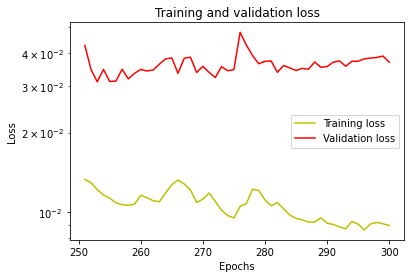

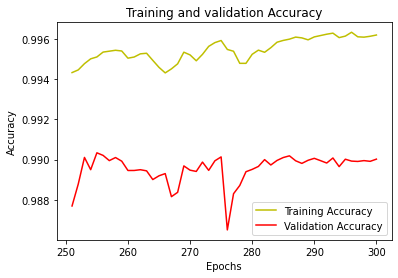

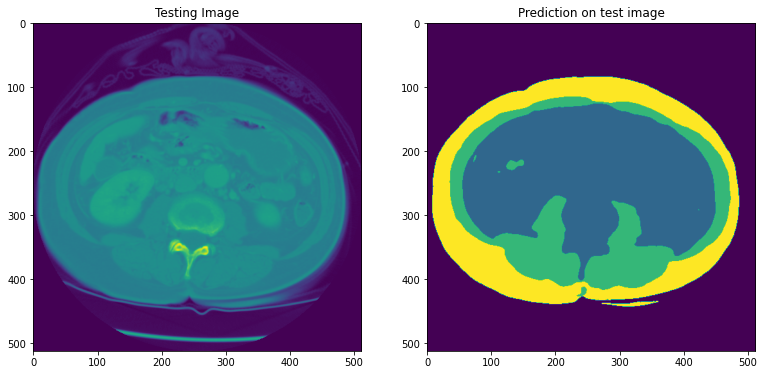

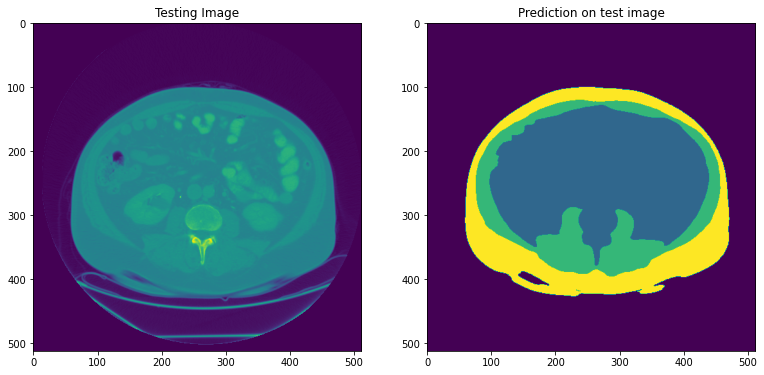

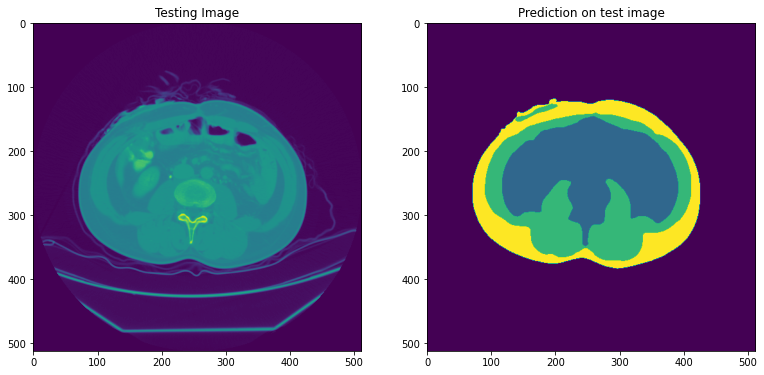

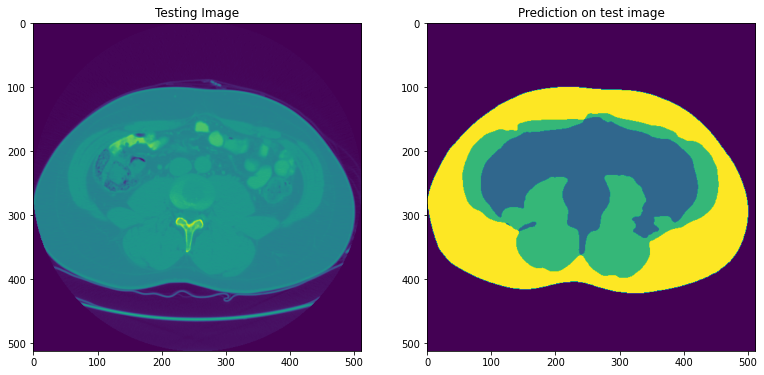

In [35]:
# history = model.fit(X_train, y_train_cat, 
#                     batch_size = 3, 
#                     verbose=1,
#                     epochs=166,
#                     validation_data=(X_valid, y_test_cat),
#                     shuffle=False)

import os

ep = 0

min_val_loss = 1
min_loss_model = 1

loss = []
val_loss = []

acc = []
val_acc = []

saved_epochs = []
saved_epochs_val_acc = []
saved_epochs_acc = []
saved_epochs_loss = []
saved_epochs_val_loss = []

while ep != 300:
    ep += 1
    print('epoch ' + str(ep) + ':')
    history = model.fit(X_train, y_train_cat, 
                    batch_size = 3, 
                    verbose=1,
                    epochs=1,
                    validation_data=(X_valid, y_test_cat),
                       )
    loss.append(history.history['loss'][0])
    val_loss.append(history.history['val_loss'][0])
    acc.append(history.history['accuracy'][0])
    val_acc.append(history.history['val_accuracy'][0])
    
    if (ep % 10 == 0):
#         os.remove('./model_' + str(ep) + '_best_of_300_epochs.hdf5')
        model.save('./model_' + str(ep) + '_best_of_300_epochs.hdf5')
    
    if history.history['val_loss'][0] <= min_val_loss:
#         os.remove('./model_best_of_300_epochs.hdf5')
        model.save('./model_best_of_300_epochs.hdf5')
        min_val_loss = history.history['val_loss'][0]
        min_loss_model = ep
        
    print(min_loss_model, min_val_loss)
        
    if ep % 10 == 0:
        l = len(loss) - 50 % len(loss)
        r = len(loss)

        epochs = range(1, len(loss) + 1)
        plt.yscale('log')
        plt.plot(epochs[l:r], loss[l:r], 'y', label='Training loss')
        plt.plot(epochs[l:r], val_loss[l:r], 'r', label='Validation loss')
        plt.title('Training and validation loss')
        plt.xlabel('Epochs')
        plt.ylabel('Loss')
        plt.legend()
        plt.show()

        plt.plot(epochs[l:r], acc[l:r], 'y', label='Training Accuracy')
        plt.plot(epochs[l:r], val_acc[l:r], 'r', label='Validation Accuracy')
        plt.title('Training and validation Accuracy')
        plt.xlabel('Epochs')
        plt.ylabel('Accuracy')
        plt.legend()
        plt.show()
        
        for i in [0, 2, 5, 19]:
            test_img = X_test[i]
            test_img=test_img[:,:,0][:,:,None]
            test_img_input=np.expand_dims(test_img, 0)
            prediction = (model.predict(test_img_input))

            predicted_img=np.argmax(prediction, axis=3)[0,:,:]

            plt.figure(figsize=(20, 15))
            plt.subplot(231)
            plt.title('Testing Image')
            plt.imshow(test_img[:,:,0])
            plt.subplot(232)
            plt.title('Prediction on test image')
            plt.imshow(predicted_img)
            plt.show()

### 5. DICE метрика
Для проверки своих результатов на валидации можно воспользоваться numpy версией **Dice loss** или взять заточенную под Ваш фреймворк функцию отсюда (не забудьте учесть, что в задаче не два класса):

[Метрики / Лоссы](https://www.kaggle.com/bigironsphere/loss-function-library-keras-pytorch)

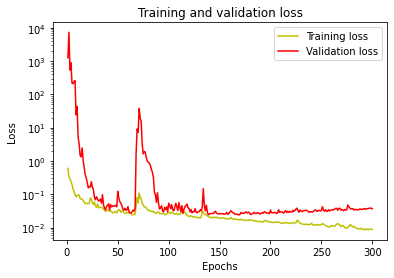

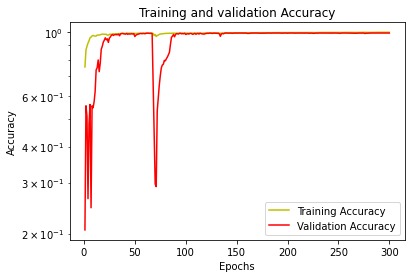

In [36]:
# model.save('./model_200_epochs_dropout.hdf5')
# model = load_model('./model_best_of_170_epochs.hdf5')

# loss = history.history['loss']
# val_loss = history.history['val_loss']

# saved_epochs = []
# saved_epochs_val_acc = []
# saved_epochs_acc = []
# saved_epochs_loss = []
# saved_epochs_val_loss = []

# loss = saved_epochs_loss
# val_loss = saved_epochs_val_loss
l = 0
r = len(loss)

# l = 45
# r = 166

# epochs = 250

# epochs = saved_epochs
epochs = range(1, len(loss) + 1)
plt.yscale('log')
plt.plot(epochs[l:r], loss[l:r], 'y', label='Training loss')
plt.plot(epochs[l:r], val_loss[l:r], 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

# acc = history.history['accuracy']
# val_acc = history.history['val_accuracy']

# acc = saved_epochs_acc
# val_acc = saved_epochs_val_acc

plt.yscale('log')
plt.plot(epochs[l:r], acc[l:r], 'y', label='Training Accuracy')
plt.plot(epochs[l:r], val_acc[l:r], 'r', label='Validation Accuracy')
plt.title('Training and validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [38]:
from keras.models import load_model
model = load_model('./model_best_of_300_epochs.hdf5')

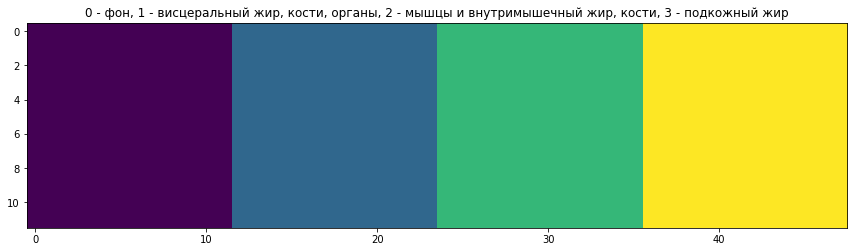

In [39]:

plt.figure(figsize=(50, 30))

classes_title = np.array(['0 - фон',
'1 - висцеральный жир, кости, органы',
'2 - мышцы и внутримышечный жир, кости',
'3 - подкожный жир'])

classes_image = np.empty(144)
classes_image.fill(0)
classes_image = classes_image.reshape(12, 12)

for cl in range(1, 4):
    class_color = np.empty(144)
    class_color.fill(cl)
    class_color = class_color.reshape(12, 12)
    classes_image = np.concatenate((classes_image, class_color), axis=1)
    
    
plt.subplot(231)
plt.title('0 - фон, '+
'1 - висцеральный жир, кости, органы, '+
'2 - мышцы и внутримышечный жир, кости, '+
'3 - подкожный жир')
plt.imshow(classes_image)

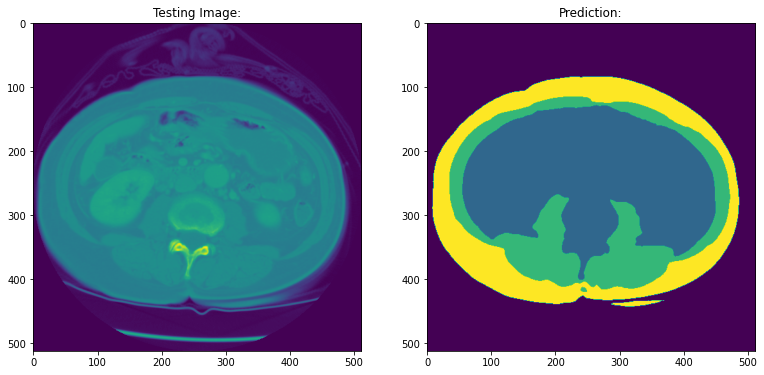

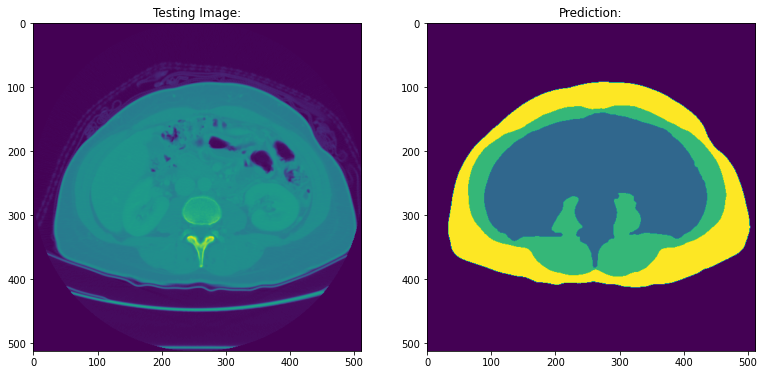

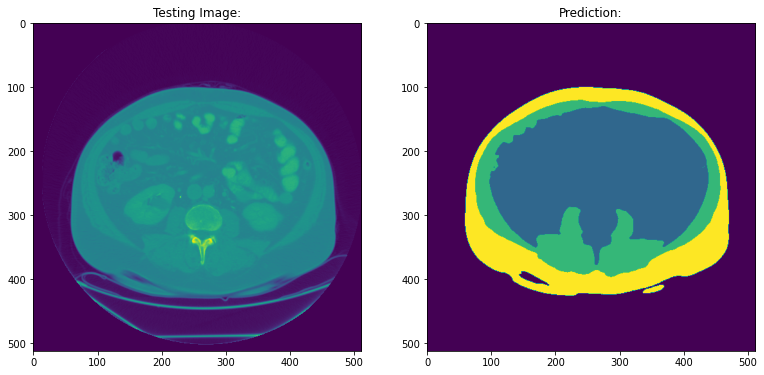

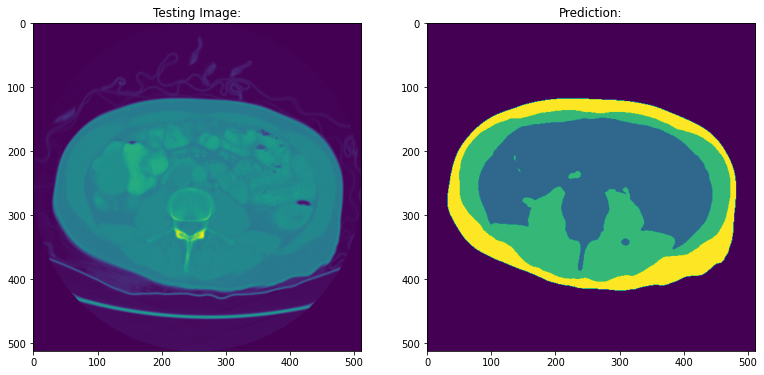

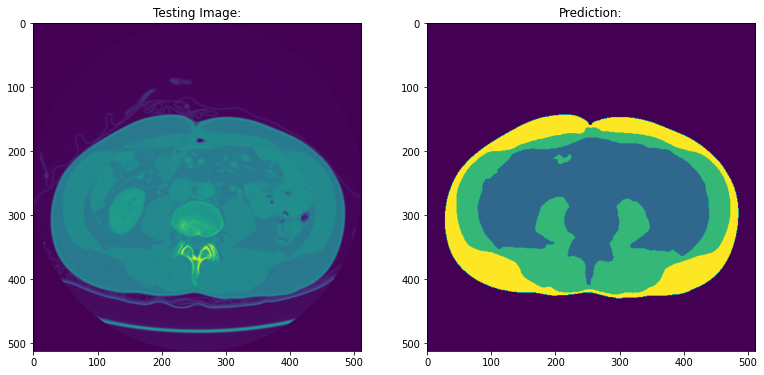

...

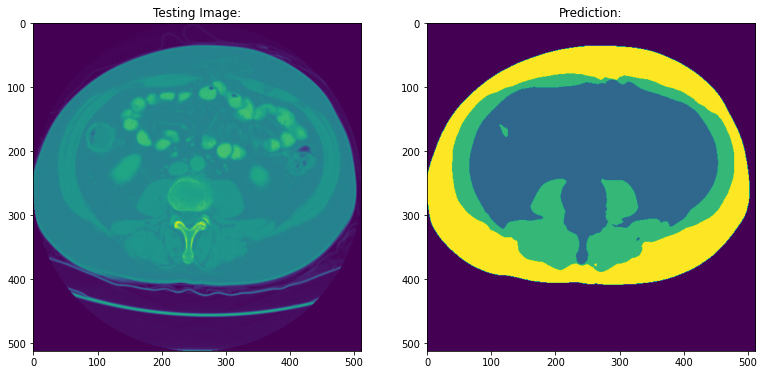

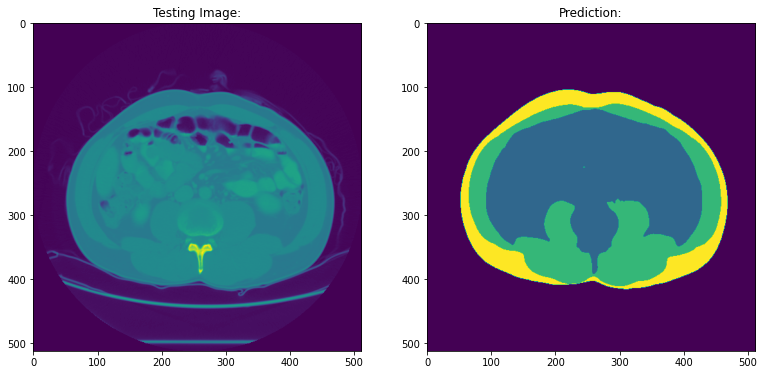

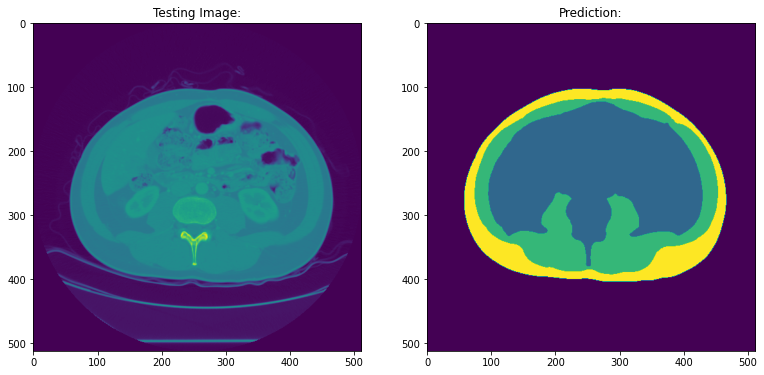

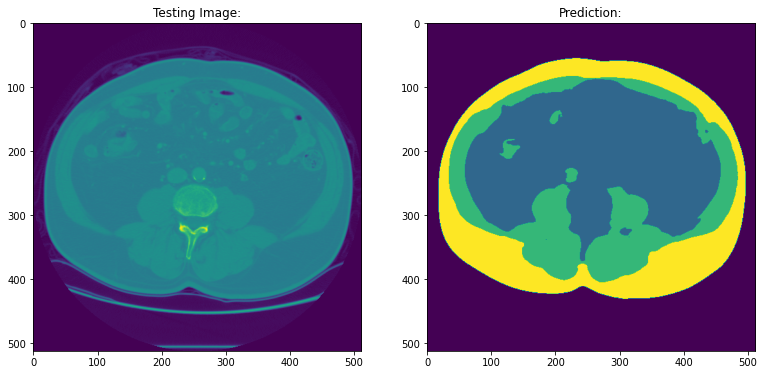

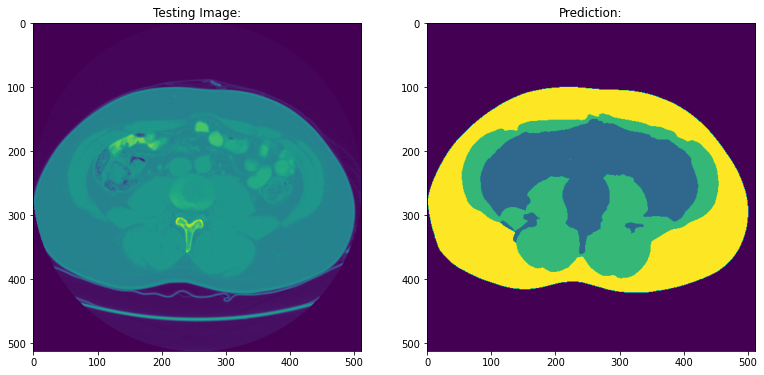

In [40]:
for test_img_number in range(len(X_test)):
    test_img = X_test[test_img_number]
    test_img=test_img[:,:,0][:,:,None]
    test_img_input=np.expand_dims(test_img, 0)
    prediction = (model.predict(test_img_input))
    
    predicted_img=np.argmax(prediction, axis=3)[0,:,:]
    
    plt.figure(figsize=(20, 15))
    plt.subplot(231)
    plt.title('Testing Image:')
    plt.imshow(test_img[:,:,0])
    plt.subplot(232)
    plt.title('Prediction:')
    plt.imshow(predicted_img)
    plt.show()

### Сохранение результатов на тестовой выборке
Сохраняем полученные маски в **csv** file

In [41]:
def rle_encoding(mask):
        dots = np.where(mask.T.flatten()==1)[0]
        run_lengths = []
        prev = -2
        for b in dots:
            if (b>prev+1): run_lengths.extend((b+1, 0))
            run_lengths[-1] += 1
            prev = b
        return run_lengths    


def write_submission(y):
    df = pd.DataFrame(columns=['ImageID', 'EncodedPixels'])
    for i, mask in enumerate(y):
        mask1 = (mask == 1).astype(int)
        mask2 = (mask == 2).astype(int)
        mask3 = (mask == 3).astype(int)
        df.loc[3 * i] = [str(3 * i), ""]
        df.loc[3 * i + 1] = [str(3 * i + 1), ""]
        df.loc[3 * i + 2] = [str(3 * i + 2), ""]
        encoded_mask = ' '.join([str(val) for val in rle_encoding(mask1)])
        df.loc[3 * i]['EncodedPixels'] = encoded_mask
        encoded_mask = ' '.join([str(val) for val in rle_encoding(mask2)])
        df.loc[3 * i + 1]['EncodedPixels'] = encoded_mask
        encoded_mask = ' '.join([str(val) for val in rle_encoding(mask3)])
        df.loc[3 * i + 2]['EncodedPixels'] = encoded_mask
    return df

y_pred=model.predict(X_test)
y_pred=np.argmax(y_pred, axis=3)

df = write_submission(y_pred)
df.to_csv('./submission.csv', index=False)
df.shape

(60, 2)

In [ ]:
from IPython.display import FileLink
FileLink(r'./submission.csv')

In [ ]:
model.save('./model_best_of_300_epochs.hdf5')